## Display FCN Activations 
 - First we generate the heatmaps, and also visually cehck them. 
- the we pass the heatmaps to the routine that prodcues the scores 

In [48]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:95% !important; }</style>"))
%matplotlib inline
%load_ext autoreload
%autoreload 2
import sys,os, pprint, pickle, json
pp = pprint.PrettyPrinter(indent=2, width=100)
print('Current working dir: ', os.getcwd())
if '..' not in sys.path:
    print("appending '..' to sys.path")
    sys.path.append('..')
    
import numpy as np
# import matplotlib as plt
import mrcnn.utils     as utils
import mrcnn.visualize as visualize
import mrcnn.prep_notebook as prep
from mrcnn.prep_notebook import build_fcn_inference_pipeline, build_mrcnn_inference_pipeline,run_mrcnn_detection,run_mrcnn_inference_pipeline
from mrcnn.prep_notebook import build_fcn_inference_pipeline_newshapes, build_mrcnn_inference_pipeline_newshapes
from mrcnn.prep_notebook import get_inference_batch, get_image_batch, run_mrcnn_detection, run_fcn_detection
from mrcnn.visualize     import display_training_batch
from mrcnn.coco          import prep_coco_dataset
from mrcnn.newshapes     import prep_newshape_dataset
import matplotlib.pyplot as plt

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Current working dir:  E:\git_projs\MRCNN3\notebooks


### Setup Coco model

In [ ]:
# WEIGHT_FILE = 'F:/models/train_fcn8_coco_adam/fcn20181109T0000/fcn_2298.h5' 
WEIGHT_FILE = 'F:/models/train_fcn8_coco_adam/fcn20181109T0000/fcn_0900.h5'
##------------------------------------------------------------------------------------
## Parse command line arguments
##------------------------------------------------------------------------------------
parser = utils.command_line_parser()
input_parms  =" --batch_size     1  "
input_parms +=" --mrcnn_logs_dir train_mrcnn_coco "
input_parms +=" --fcn_logs_dir   train_fcn8_bce " 
input_parms +=" --mrcnn_model    last "
input_parms +=" --fcn_model      " + WEIGHT_FILE + "  "
# input_parms +=" --fcn_model      last "
input_parms +=" --fcn_layer      all"
input_parms +=" --fcn_arch       fcn8 " 
input_parms +=" --sysout         screen "
input_parms +=" --scale_factor   4"
# input_parms +=" --coco_classes   78 79 80 81 82 44 46 47 48 49 50 51 34 35 36 37 38 39 40 41 42 43 "
input_parms +=" --coco_classes       78 79 80 81 82 44 46 47 48 49 50 51 34 35 36 37 38 39 40 41 42 43 10 11 13 14 15 "

args = parser.parse_args(input_parms.split())
utils.display_input_parms(args)
# import matplotlib as plt
%matplotlib inline

mrcnn_model, fcn_model = build_fcn_inference_pipeline(args = args)

### Setup Newshapes model

In [2]:
##------------------------------------------------------------------------------------
## Parse command line arguments
##------------------------------------------------------------------------------------
parser = utils.command_line_parser()
input_parms  =" --batch_size     1  "
input_parms +=" --mrcnn_logs_dir train_mrcnn_newshapes "
input_parms +=" --fcn_logs_dir   train_fcn8_l2_newshapes "
input_parms +=" --mrcnn_model    last "
input_parms +=" --fcn_model      last "
input_parms +=" --fcn_model      last "
input_parms +=" --fcn_layer      all"
input_parms +=" --fcn_arch       fcn8L2 " 
input_parms +=" --sysout         screen "
input_parms +=" --scale_factor   1"
args = parser.parse_args(input_parms.split())
# utils.display_input_parms(args)
## Configurations
 

mrcnn_model, fcn_model = prep.build_fcn_inference_pipeline_newshapes(args = args,verbose = 1)

MODE IS: inference
build_mrcnn_inference_pipeline_newshapes MODE is : inference

   Arguments passed :
   --------------------
   batch_size                     1
   coco_classes                   None
   epochs                         1
   evaluate_method                1
   fcn_arch                       FCN8L2
   fcn_layers                     ['all']
   fcn_logs_dir                   train_fcn8_l2_newshapes
   fcn_losses                     fcn_BCE_loss
   fcn_model                      last
   last_epoch                     0
   lr                             0.001
   mrcnn_exclude_layers           None
   mrcnn_layers                   ['mrcnn', 'fpn', 'rpn']
   mrcnn_logs_dir                 train_mrcnn_newshapes
   mrcnn_model                    last
   new_log_folder                 False
   opt                            ADAGRAD
   scale_factor                   1
   steps_in_epoch                 1
   sysout                         SCREEN
   val_steps                      1


DIR_TRAINING                   F:\models_newshapes
FCN_TRAINING_PATH              F:\models_newshapes\train_fcn8_l2_newshapes
FCN_VGG16_MODEL_PATH           F:\PretrainedModels\fcn_vgg16_weights_tf_dim_ordering_tf_kernels.h5
MRCNN_TRAINING_PATH            F:\models_newshapes\train_mrcnn_newshapes
RESNET_MODEL_PATH              F:\PretrainedModels\resnet50_weights_tf_dim_ordering_tf_kernels_notop.h5
SHAPES_MODEL_PATH              F:\PretrainedModels\mask_rcnn_shapes.h5
VGG16_MODEL_PATH               F:\PretrainedModels\vgg16_weights_tf_dim_ordering_tf_kernels_notop.h5

>>> Initialize ModelBase model 
   Mode      :  inference
   Model dir :  F:\models_newshapes\train_fcn8_l2_newshapes
>>> ModelBase initialiation complete
>>> Initialize FCN model, mode:  inference architecture:  FCN8L2
    arch set to FCN8 - with L2 Regularization
<function fcn8_l2_graph at 0x0000003D4429BAE8>


---------------------------------------------------
 Build FCN Model -  Arch:  FCN8L2  mode:  inference
------

    old_style_scores               :  shape: (?, 3)                KB.shape:(None, 3)             Keras Tensor: False
    alt_scores_1                   :  shape: (?, 3)                KB.shape:(None, 3)             Keras Tensor: False
    alt_scores_1_scattered         :  shape: (1, 7, 64, 3)         KB.shape:(1, 7, 64, 3)         Keras Tensor: False
    alt_scores_1_norm(by_class)    :  shape: (1, 7, 64, 3)         KB.shape:(1, 7, 64, 3)         Keras Tensor: False
    alt_scores_1_norm(by_image)    :  shape: (?, 3)                KB.shape:(None, 3)             Keras Tensor: False

    Normalize heatmap within each class !-------------------------------------
    in_heatmap_norm :  (?, 7, 128, 128) Keras tensor  False
    normalizer shape   :  (?, 7, 1, 1)
    normalized heatmap :  (?, 7, 128, 128)  Keras tensor  False
    hm_indices shape               :  shape: (?, 2)                KB.shape:(None, 2)             Keras Tensor: False
    pt2_heatmaps                   :  shape: (?, 

    Weights file loaded: F:\models_newshapes\train_fcn8_l2_newshapes\fcn20181224T0000\fcn_0793.h5 
FCN  MODEL Load weight file COMPLETE 


In [5]:
# fcn_mdl = fcn_model.keras_model
# fcn_model.keras_model.summary()

print(fcn_model.keras_model.layers[2].output.shape)
print(fcn_model.keras_model.layers[2].activation)
# dir(fcn_model.keras_model.layers[2])


(?, 128, 128, 64)
<function relu at 0x000000FBAC008AE8>


## Set and load weight files

In [7]:
# DIR_WEIGHTS = '/home/kbardool/models/train_fcn8_coco/fcn20181026T1432'
# DIR_WEIGHTS =  'F:/models/train_fcn8_bce/fcn20181205T0000' ### Training with LR=0.00001, MSE Loss NO L2 Regularization
DIR_WEIGHTS =  'F:/models_newshapes/train_fcn8_l2_newshapes/fcn20181224T0000' ### Training with LR=0.00001, MSE Loss NO L2 Regularization
# DIR_WEIGHTS =  '/home/kbardool/models/train_fcn8_coco/fcn20181031T0000' ### Training with LR=0.00001, MSE Loss NO L2 Regularization
# files = ['fcn_0001.h5','fcn_0027.h5','fcn_0036.h5','fcn_0051.h5','fcn_0076.h5','fcn_0106.h5','fcn_0156.h5']
# files   = ['fcn_0104.h5','fcn_0150.h5','fcn_0205.h5','fcn_0249.h5','fcn_0293.h5','fcn_0346.h5','fcn_0419.h5']
files   = ['fcn_0001.h5','fcn_0150.h5','fcn_0346.h5','fcn_0419.h5','fcn_0421.h5',
           'fcn_0434.h5','fcn_0450.h5','fcn_0482.h5','fcn_0521.h5','fcn_0610.h5',
           'fcn_0687.h5','fcn_0793.h5']

FILE_IDX = 2
weights_file = os.path.join(DIR_WEIGHTS  , files[FILE_IDX])
print("Loading weights ", weights_file)
fcn_model.load_model_weights(weights_file)

##  Datasets

###  Prep COCO Dataset

In [13]:
print('load coco classes: ', args.coco_classes)
load_class_ids = args.coco_classes
dataset_test, test_generator = prep_coco_dataset(["train", "val35k"], mrcnn_model.config, generator = True , return_coco = False, load_coco_classes =load_class_ids)
dataset_test.display_class_info()
dataset_test.display_active_class_info()
print("Testing Dataset Image Count: {}".format(len(dataset_test.image_ids)))
print("Testing Dataset Class Count: {}".format(dataset_test.num_classes))
coco_class_names = dataset_test.class_names


load coco classes:  [78, 79, 80, 81, 82, 44, 46, 47, 48, 49, 50, 51, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 10, 11, 13, 14, 15]
COCO loading annotations file F:\MLDatasets\coco2014\annotations/instances_train2014.json  into memory...
Done (t=17.03s)
creating index...
index created!
 load subset of classes:  [78, 79, 80, 81, 82, 44, 46, 47, 48, 49, 50, 51, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 10, 11, 13, 14, 15]
 image dir            :  F:\MLDatasets\coco2014\train2014
 json_path_dir        :  F:\MLDatasets\coco2014\annotations/instances_train2014.json
 number of images     :  40400
 image_ids[:10]       :  [262146, 524291, 9, 393227, 393230, 131087, 393241, 393242, 131099, 393251]
 image_ids[1000:1010] :  [396150, 265080, 396157, 2951, 396172, 134032, 134033, 527250, 2963, 2964]
COCO loading annotations file F:\MLDatasets\coco2014\annotations/instances_valminusminival2014.json  into memory...
Done (t=11.19s)
creating index...
index created!
 load subset of classes:  [78, 79, 80, 81

### Prep Newshapes Dataset

In [3]:
# del dataset_train, dataset_val, train_generator, val_generator
# dataset_test , test_generator   = prep_newshape_dataset( mrcnn_model.config,  1000, generator=True)
# with open('newshapes_dataset_1000_B.pkl', 'wb') as outfile:
#     pickle.dump(dataset_test, outfile)
## -- OR --

# with open("E:\\git_projs\\MRCNN3\\train_newshapes\\newshapes_dataset.pkl", 'rb') as infile:
with open("E:\\git_projs\\MRCNN3\\train_newshapes\\newshapes_dataset_1000_B.pkl", 'rb') as infile:
    dataset_test = pickle.load(infile)

In [4]:
dataset_test.display_active_class_info()
print("Testing Dataset Image Count: {}".format(len(dataset_test.image_ids)))
print("Testing Dataset Class Count: {}".format(dataset_test.num_classes))
class_names = dataset_test.class_names

[1, 2, 3, 4, 5, 6]
internal_class:  1 ext_cls: 1 name: None - person
internal_class:  2 ext_cls: 2 name: None - car
internal_class:  3 ext_cls: 3 name: None - sun
internal_class:  4 ext_cls: 4 name: None - building
internal_class:  5 ext_cls: 5 name: None - tree
internal_class:  6 ext_cls: 6 name: None - cloud
Testing Dataset Image Count: 1000
Testing Dataset Class Count: 7


###  Display some images from dataset

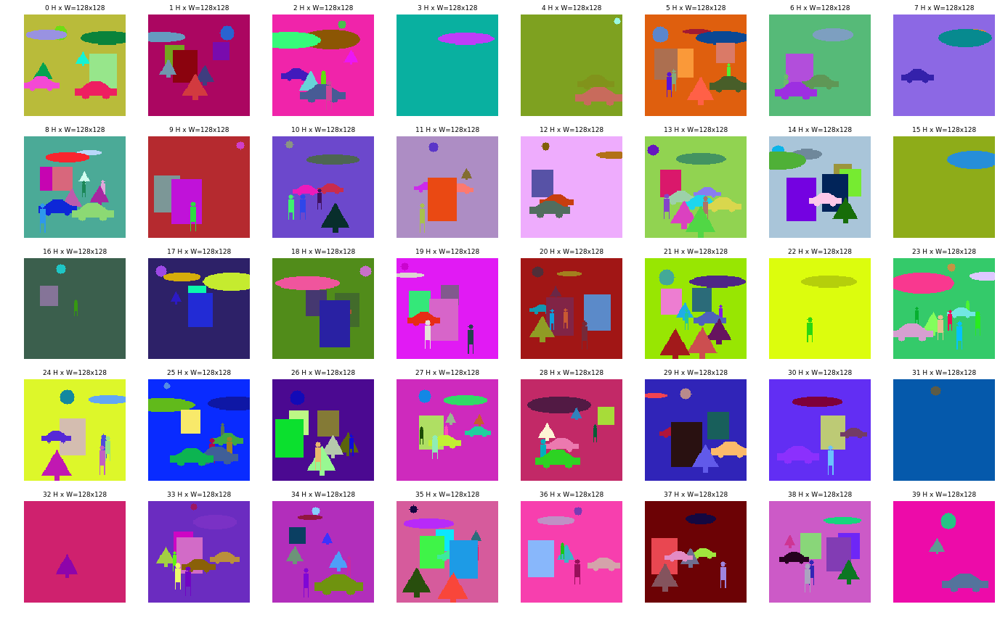

In [5]:
image_list = list(range(0,40))
image_titles = [str(i) for i in image_list]
images = get_image_batch(dataset_test, image_list)
visualize.display_images(images, titles = image_titles, cols = 8, width = 24)

####  Display next image from generator

image id :  91
 Image_id    :  91  Reference:  [('cloud', (209, 232, 173), (53, 31, 37, 7)), ('person', (10, 102, 243), (83, 65, 2, 10)), ('tree', (194, 68, 131), (46, 69, 14, 14)), ('person', (126, 129, 23), (84, 82, 2, 14)), ('person', (231, 133, 22), (62, 88, 3, 15)), ('car', (247, 125, 84), (62, 107, 30, 15))] Coco Id: 91
 Image meta  :  [ 91 128 128   3   0   0 128 128]
 Class ids   :  (6,)    [6 1 5 1 1 2]
 Class Names :  ['cloud', 'person', 'tree', 'person', 'person', 'car']


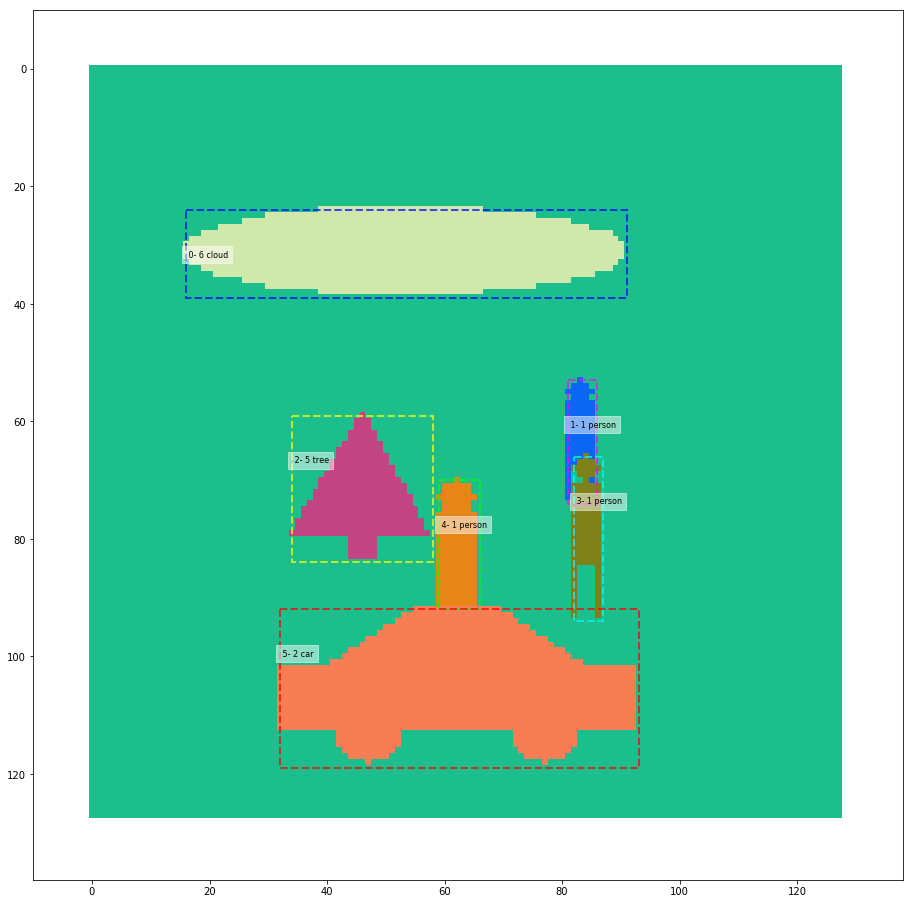

6

In [13]:
# batch_x, batch_y = next(test_generator)
visualize.display_training_batch(dataset_test,  batch_x)
len(batch_x)

#### Load a specific image using image_id

In [ ]:
from mrcnn.prep_notebook import run_full_inference_pipeline, run_mrcnn_inference_pipeline
# IMAGE_LIST = []      ## 62642 (persons),   68539 (trucks)36466 (surfers)  75040 (boat and persons)
# IMAGE_LIST = [36466] ## 36466 surfers. 5498 basketbal players, 27711,30531
# IMAGE_LIST = [5498] lots of motorcylces & persons - 
## Persons: #26026, #7719, 111864, 58240,  
# IMAGE_LIST = [89243] ##: Person, bicycle and traiffic lights
# IMAGE_LIST = [35347] ## - people and skaeboard  
# IMAGE_LIST = [59199]  ## books , sofa, living room
# IMAGE_LIST = [102868]  ## person in an airplane
# IMAGE_LIST = [101623] ## (cake and forks)
IMAGE_LIST = [107200]   ## people, snow and skis
# IMAGE_LIST = [41423]  ## (elephant & people)
# IMAGE_LIST = [49316]  ## Table, book, backpack, many bottles
# IMAGE_LIST = [75040] 
# IMAGE_LIST = [89243]
# IMAGE_LIST = [33477]  ## Table, bowl, cup, sandwich, knife
# IMAGE_LIST = [29731]
# IMAGE_LIST = [26763]  ## Table, chair, cup , bowl, bottle
# mrcnn_input = demo_image(dataset_train, mrcnn_model.config, IMAGE_LIST)
# outputs = run_mrcnn_inference_pipeline(mrcnn_model, dataset_test, image_ids = [50494] , verbose = 1)

In [15]:
# outputs = run_full_inference_pipeline(mrcnn_model, fcn_model, dataset_test, image_ids = [50494] , verbose = 1)

print(type(outputs), outputs.keys())

## Pass image through MRCNN and FCN

In [171]:
dataset_test.image_info[3]['shapes'].pop()

pp.pprint(dataset_test.image_info[3])

{ 'bg_color': array([  9, 176, 160]),
  'height': 128,
  'id': 3,
  'path': None,
  'shapes': [('cloud', (191, 60, 248), (87, 30, 35, 7))],
  'source': 'shapes',
  'width': 128}


In [172]:

## object is (shape, color, dims)
# color = tuple([random.randint(0, 255) for _ in range(3)])
yellow = (228, 236, 53)
black = (22, 31, 4)
# dims  = (10,110,20,8)
# -- add sun in bottom right 
# obj = ('sun', yellow , (100, 120, 12, 12))
# obj = ('sun', black, (100, 120, 12, 12))
obj =('person', (224, 188, 174), (23, 18, 2, 10))
# -- add car to top area
# obj = ('car', (64, 67, 30), (25,5,15,10))
# -- add car to bottom right area
# obj = ('car', color , (103,120,15,10))
# -- add building
# obj =("building",color, (25,110,10,15))
# -- add an object at a random position
# color, dims =dataset_test.random_shape("sun", 128,128) 

# --append the object to the image
# dataset_test.image_info[image_id]['shapes'].append((shape, color, dims))
dataset_test.image_info[3]['shapes'].append(obj)
pp.pprint(dataset_test.image_info[3])

{ 'bg_color': array([  9, 176, 160]),
  'height': 128,
  'id': 3,
  'path': None,
  'shapes': [ ('cloud', (191, 60, 248), (87, 30, 35, 7)),
              ('person', (224, 188, 174), (23, 18, 2, 10))],
  'source': 'shapes',
  'width': 128}


### Get image for inference run

Processing 1 images
image                    shape: (128, 128, 3)         min:    9.00000  max:  248.00000
molded_images            shape: (1, 128, 128, 3)      min: -114.70000  max:  144.10001
image_metas              shape: (1, 15)               min:    0.00000  max:  128.00000
image id :  3
 Image_id    :  3  Reference:  [('cloud', (191, 60, 248), (87, 30, 35, 7)), ('person', (224, 188, 174), (23, 18, 2, 10))] Coco Id: 3
 Image meta  :  [  3 128 128   3   0   0 128 128]
 Class ids   :  (2,)    [6 1]
 Class Names :  ['cloud', 'person']


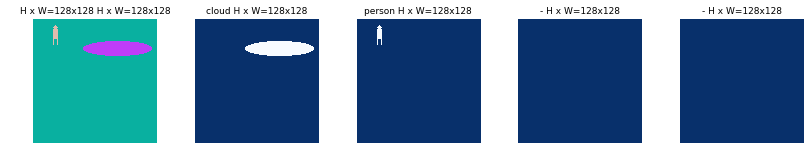

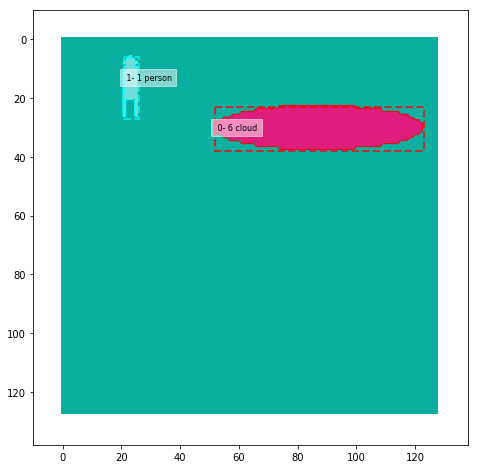

In [173]:
batch_x = prep.get_inference_batch(dataset_test, mrcnn_model.config, image_ids =3, display= True)

In [174]:
output = prep.run_mrcnn_inference_pipeline(mrcnn_model, dataset_test,  input= batch_x, verbose = 1)

** Pass through MRCNN model:
/* Inputs */
Input  0:  (input_image:0                           ) 	  Input shape: (1, 128, 128, 3)
Input  1:  (input_image_meta:0                      ) 	  Input shape: (1, 15)

Requested layers:
-----------------
Layer   0:  (mrcnn_detection/detections:0            ) 	  Output shape: <unknown>
Layer   1:  (ROI/rpn_roi_proposals:0                 ) 	  Output shape: (1, ?, ?)
Layer   2:  (mrcnn_class_lambda/mrcnn_class:0        ) 	  Output shape: (?, 1000, 7)
Layer   3:  (mrcnn_bbox_lambda/mrcnn_bbox:0          ) 	  Output shape: (?, 1000, 7, 4)
Layer   4:  (cntxt_layer/pred_heatmap:0              ) 	  Output shape: (1, 128, 128, 7)
Layer   5:  (cntxt_layer/pred_heatmap_scores:0       ) 	  Output shape: (1, 7, 64, 24)

/* Outputs */
Output idx:  0    Layer:  0: (mrcnn_detection/detections:0            ) 	  Output shape: (1, 64, 7)
Output idx:  1    Layer:  1: (ROI/rpn_roi_proposals:0                 ) 	  Output shape: (1, 1000, 4)
Output idx:  2    Layer:  

In [149]:
for i in output['mrcnn_output']:
    print(i.shape)

(1, 64, 7)
(1, 1000, 4)
(1, 1000, 7)
(1, 1000, 7, 4)
(1, 128, 128, 7)
(1, 7, 64, 24)


### Load model input and outputs

In [175]:
# mrcnn_model.layer_info()
# from mrcnn.prep_notebook import run_pipeline, run_pipeline_on_input
# mrcnn_output, fcn_output, fcn_input = run_pipeline_on_input(mrcnn_model, fcn_model, mrcnn_input, verbose = 0)
model_detections                = output['mrcnn_output'][0]          # layer:  0   shape: (1, 64, 7)
model_rpn_roi_proposals         = output['mrcnn_output'][1]          # layer:  1   shape: (1, 1000, 4)
model_mrcnn_class               = output['mrcnn_output'][2]          # layer:  2   shape: (1, 1000, 7)
model_mrcnn_bbox                = output['mrcnn_output'][3]          # layer:  3   shape: (1, 1000, 7, 4)
model_pr_heatmap              = output['mrcnn_output'][4]          # layer:  4   shape: (1, 128, 128, 7)
model_pr_heatmap_scores       = output['mrcnn_output'][5]          # layer:  5   shape: (1, 7, 64, 24)
# model_pr_heatmap                = mrcnn_output['mrcnn_output'][0]          # layer:  0   shape: (1, 256, 256, 81)
# model_pr_heatmap_scores         = mrcnn_output['mrcnn_output'][1]          # layer:  1   shape: (1, 81, 200, 11)
# model_gt_heatmap                = mrcnn_output['mrcnn_output'][2]          # layer:  2   shape: (1, 256, 256, 81)
# model_gt_heatmap_scores         = mrcnn_output['mrcnn_output'][3]          # layer:  3   shape: (1, 81, 200, 11)
# model_fcn_heatmap               = mrcnn_output['fcn_output'][0]          # layer:  0   shape: (1, 256, 256, 81)
# model_fcn_softmax               = mrcnn_output['fcn_output'][1]          # layer:  1   shape: ()
# model_MSE_loss                  = mrcnn_output['fcn_output'][2]          # layer:  1   shape: ()
# model_CE_loss                   = mrcnn_output['fcn_output'][3]          # layer:  1   shape: ()
# # print('model_pr_heatmap       : ',model_gt_heatmap.shape)
# print('model_pr_heatmap_scores: ',model_gt_heatmap_scores.shape)
# print('model_gt_heatmap       : ',model_gt_heatmap.shape)
# print('model_gt_heatmap_scores: ',model_gt_heatmap_scores.shape)
# print('model_fcn_heatmap      :', model_fcn_heatmap.shape)
# print('model_fcn_softmax      :', model_fcn_softmax.shape)
# print(model_CE_loss,model_MSE_loss)
print(model_pr_heatmap_scores.shape)
img_id = 0
print('Image id: ',img_id, ' Coco ID: ', dataset_test.image_info[img_id]['id'])
# gt_class_ids = np.unique(model_gt_heatmap_scores[img_id,:,:,4]).astype(int).tolist()
pr_class_ids = np.unique(model_pr_heatmap_scores[img_id,:,:,4]).astype(int).tolist()
# print('Image : {}  Ground Truth ClassIds: {}'.format(img_id, gt_class_ids))
print('Image : {}  Predicted    ClassIds: {}'.format(img_id, pr_class_ids))

(1, 7, 64, 24)
Image id:  0  Coco ID:  0
Image : 0  Predicted    ClassIds: [0, 1, 3, 6]


## Build Activation Model

In [54]:
from keras import models
# del fcn_mdl
model = fcn_model.keras_model
model.summary()


__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_pr_hm_norm (InputLayer)   (None, 128, 128, 7)  0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 128, 128, 64) 4096        input_pr_hm_norm[0][0]           
__________________________________________________________________________________________________
block1_conv2 (Conv2D)           (None, 128, 128, 64) 36928       block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_pool (MaxPooling2D)      (None, 64, 64, 64)   0           block1_conv2[0][0]               
__________________________________________________________________________________________________
block2_con

#### identify layers we want to visualize

In [11]:
# my_layers = ['res5c_out','res4w_out', 'res3d_out', 'res2c_out', 'max_pooling2d_1', 'activation_1', 'bn_conv1', 'conv1']
my_layers = ['block1_pool', 'block2_pool', 'block3_pool', 'block4_pool', 'block5_pool', 
             'fcn32_deconv2D'  , 'fcn16_score2', 
             'fcn16_score_pool4', 'fcn16_fuse_pool4', 'fcn16_upscore_pool4',
             'fcn8_score_pool3', 'fcn8_fuse_pool3', 'fcn8_heatmap', 'fcn_softmax_lambda' ]
# my_layers = ['block1_conv1', 'block1_conv2','block1_pool' , 'block2_conv1', 'block2_conv2', 'block2_pool']

my_ids = []
for i, layer in enumerate(model.layers):
    if layer.name in my_layers:
        print(i, model.layers[i].name)
        my_ids.append(i)
    # print(fcn_mdl.layers[2].output.shape)
# print(fcn_mdl.layers[2].activation)
# # dir(fcn_mdl.layers[2])
print(my_ids)
layer_outputs = [model.layers[i].output  for i in my_ids]
layer_names   = [model.layers[i].name    for i in my_ids]

3 block1_pool
6 block2_pool
10 block3_pool
14 block4_pool
18 block5_pool
23 fcn32_deconv2D
24 fcn16_score2
26 fcn16_score_pool4
27 fcn16_fuse_pool4
28 fcn16_upscore_pool4
30 fcn8_score_pool3
31 fcn8_fuse_pool3
32 fcn8_heatmap
35 fcn_softmax_lambda
[3, 6, 10, 14, 18, 23, 24, 26, 27, 28, 30, 31, 32, 35]


In [176]:
activation_model = models.Model(inputs = model.input, outputs=layer_outputs)

print(layer_names)
print('inputs:')
pp.pprint(activation_model.input)
print('outputs:')
pp.pprint(activation_model.output)

['block1_pool', 'block2_pool', 'block3_pool', 'block4_pool', 'block5_pool', 'fcn32_deconv2D', 'fcn16_score2', 'fcn16_score_pool4', 'fcn16_fuse_pool4', 'fcn16_upscore_pool4', 'fcn8_score_pool3', 'fcn8_fuse_pool3', 'fcn8_heatmap', 'fcn_softmax_lambda']
inputs:
[ <tf.Tensor 'input_pr_hm_norm:0' shape=(?, 128, 128, 7) dtype=float32>,
  <tf.Tensor 'input_pr_hm_scores:0' shape=(?, 7, 64, 24) dtype=float32>]
outputs:
[ <tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 64, 64, 64) dtype=float32>,
  <tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 32, 32, 128) dtype=float32>,
  <tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 16, 16, 256) dtype=float32>,
  <tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 8, 8, 512) dtype=float32>,
  <tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 4, 4, 512) dtype=float32>,
  <tf.Tensor 'fcn32_deconv2D/BiasAdd:0' shape=(?, 4, 4, 7) dtype=float32>,
  <tf.Tensor 'fcn16_score2/BiasAdd:0' shape=(?, ?, ?, 7) dtype=float32>,
  <tf.Tensor 'fcn16_score_pool4/Relu:0' shape=(?, 8, 8, 7) dtyp

In [177]:
activations = activation_model.predict([model_pr_heatmap, model_pr_heatmap_scores])

for act in activations:
    print(act.shape)

(1, 64, 64, 64)
(1, 32, 32, 128)
(1, 16, 16, 256)
(1, 8, 8, 512)
(1, 4, 4, 512)
(1, 4, 4, 7)
(1, 10, 10, 7)
(1, 8, 8, 7)
(1, 8, 8, 7)
(1, 16, 16, 7)
(1, 16, 16, 7)
(1, 16, 16, 7)
(1, 128, 128, 7)
(1, 128, 128, 7)


##  Display Activations

In [158]:
import math
def display_fcn_input(fcn_hm):
    columns = 8
    
    n_features = fcn_hm.shape[-1]
    rows = math.ceil(n_features / columns )

#     print()
#     print('Layer:', LAYER, ' - ',layer_names[LAYER], '   Shape: ', activations[LAYER][0,:,:,:].shape, ' # features: ', n_features, rows, columns)
    fig = plt.figure(figsize=(8 *columns, 7* rows))
    for idx in range(n_features): 
        row = idx // columns
        col = idx  % columns
        subplot = (row * columns) + col +1    
        ax= fig.add_subplot(rows, columns, subplot)
        surf = ax.matshow(fcn_hm[0,:,:,idx], cmap='gray', interpolation='none')
        fig.colorbar(surf, shrink=0.6, aspect=30, fraction=0.05)
    title = 'FCN Input - shape: {}'.format(str(fcn_hm.shape))        
    fig.suptitle(title, fontsize = 24, ha ='center' )        
    

def display_activations(activations, layer, columns = 8):
    LAYER = layer
    n_features = activations[LAYER].shape[-1]
    rows = math.ceil(n_features / columns )

#     print()
#     print('Layer:', LAYER, ' - ',layer_names[LAYER], '   Shape: ', activations[LAYER][0,:,:,:].shape, ' # features: ', n_features, rows, columns)
    fig = plt.figure(figsize=(8 *columns, 7* rows))
    for idx in range(n_features): 
        row = idx // columns
        col = idx  % columns
        subplot = (row * columns) + col +1    
        ax= fig.add_subplot(rows, columns, subplot)
        surf = ax.matshow(activations[LAYER][0,:,:,idx], cmap='viridis', interpolation='none')
        fig.colorbar(surf, shrink=0.6, aspect=30, fraction=0.05)
    title = 'Layer: {:3d} - {:25s} - shape: {}'.format(LAYER,layer_names[LAYER], str(activations[LAYER][0].shape))        
    fig.suptitle(title, fontsize = 24, ha ='center' )        
    
    
def display_final_activations(activations, layers, columns = 8):
    n_layers   = len(layers)
    
    
    fig_num = 1
    for layer in layers:
        LAYER = layer
        n_features = activations[LAYER].shape[-1]
        rows = math.ceil(n_features / columns )

    #     print()
    #     print('Layer:', LAYER, ' - ',layer_names[LAYER], '   Shape: ', activations[LAYER][0,:,:,:].shape, ' # features: ', n_features, rows, columns)
        fig = plt.figure(fig_num, figsize=(8 *columns, 7* rows))
        for idx in range(n_features): 
            row = idx // columns
            col = idx  % columns
            subplot = (row * columns) + col +1    
            plt.subplot(rows, columns, subplot)
            ax = plt.gca()
            ax.set_title(class_names[idx])
            surf = ax.matshow(activations[LAYER][0,:,:,idx], cmap='jet', interpolation='none', vmin=-1.0, vmax=1.0)
            
            fig.colorbar(surf, shrink=0.6, aspect=30, fraction=0.05)
        title = 'Layer: {:3d} - {:25s} - shape: {}'.format(LAYER,layer_names[LAYER], str(activations[LAYER][0].shape))        
        fig.suptitle(title, fontsize = 24, ha ='center' )            
#         fig.savfig
        fig_num +=1
#     import matplotlib.backends.backend_pdf
# pdf = matplotlib.backends.backend_pdf.PdfPages("output.pdf")
# for fig in xrange(1, figure().number): ## will open an empty extra figure :(
#     pdf.savefig( fig )
# pdf.close()
    plt.show()

In [46]:
def display_final_activations_2(activations, layers, columns = 8):
    import matplotlib.backends.backend_pdf
    pdf = matplotlib.backends.backend_pdf.PdfPages("output.pdf")

    n_layers   = len(layers)
    
    fig = plt.figure(  figsize=(8 *columns, 7* n_layers))
    
    fig_num = 1
    for row, layer in enumerate(layers):
        LAYER = layer
        n_features = activations[LAYER].shape[-1]
        rows = math.ceil(n_features / columns )

    #     print()
    #     print('Layer:', LAYER, ' - ',layer_names[LAYER], '   Shape: ', activations[LAYER][0,:,:,:].shape, ' # features: ', n_features, rows, columns)
        for col in range(n_features): 
#             row = idx // columns
#             col = idx  % columns

            subplot = (row * columns) + col +1    
            print(n_layers, n_features, subplot)
            plt.subplot(rows, columns, subplot)
            ax = plt.gca()
            surf = ax.matshow(activations[LAYER][0,:,:,col], cmap='viridis', interpolation='none')
            fig.colorbar(surf, shrink=0.6, aspect=30, fraction=0.05)
        title = 'Layer: {:3d} - {:25s} - shape: {}'.format(LAYER,layer_names[LAYER], str(activations[LAYER][0].shape))        
        fig.suptitle(title, fontsize = 24, ha ='center' )            
        pdf.savefig( fig_num )

        fig_num +=1
        
    pdf.close()
    plt.show()

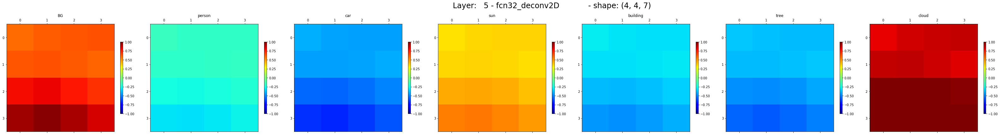

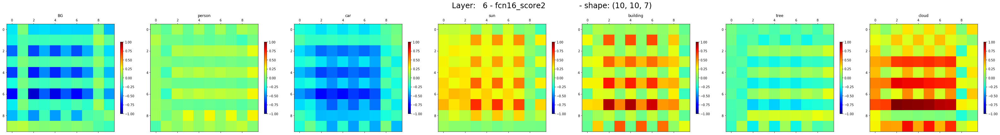

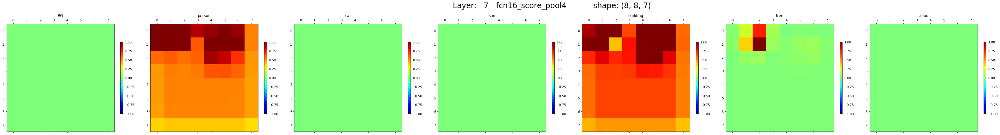

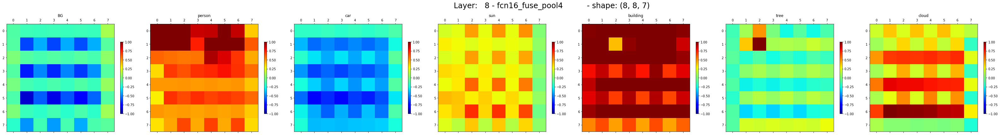

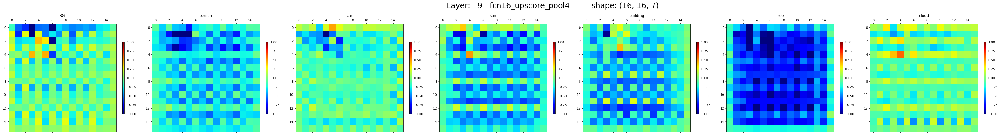

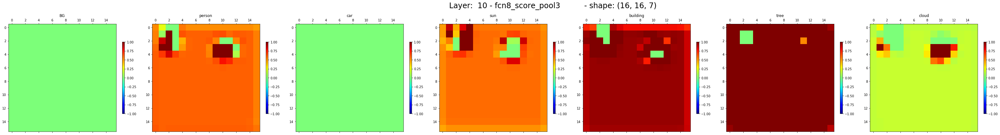

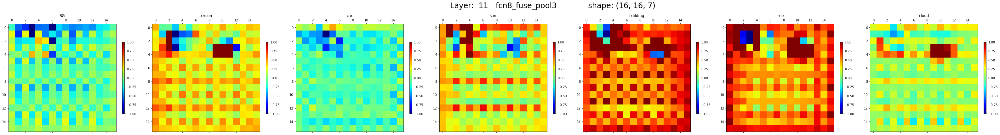

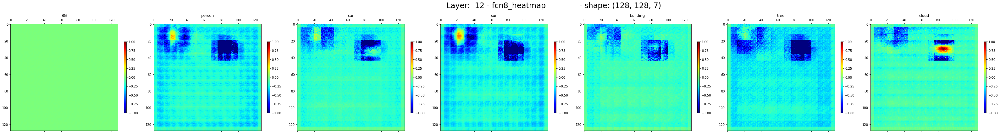

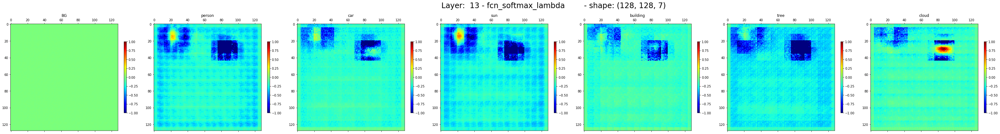

In [178]:
# internal_class:  1 ext_cls: 1 name: None - person
# internal_class:  2 ext_cls: 2 name: None - car
# internal_class:  3 ext_cls: 3 name: None - sun
# internal_class:  4 ext_cls: 4 name: None - building
# internal_class:  5 ext_cls: 5 name: None - tree
# internal_class:  6 ext_cls: 6 name: None - cloud
# display_activations(activations,9, columns = 3)
layers = list(range(5, len(activations)))
display_final_activations(activations, layers)

In [ ]:
# internal_class:  1 ext_cls: 1 name: None - person
# internal_class:  2 ext_cls: 2 name: None - car
# internal_class:  3 ext_cls: 3 name: None - sun
# internal_class:  4 ext_cls: 4 name: None - building
# internal_class:  5 ext_cls: 5 name: None - tree
# internal_class:  6 ext_cls: 6 name: None - cloud

### Display argmax of fcn_softmax

In [180]:
np.set_printoptions(linewidth=195, precision=4, floatmode='fixed', threshold =100000)
dataset_test.display_active_class_info()
# sm =  fcn_results[0]['fcn_sm']
sm =  activations[-1]
print(sm.shape)
cls_max2 = np.argmax(sm, axis = -1)
print('CLS_MAX2 : ',cls_max2.shape)
print(utils.mask_string(cls_max2))

[1, 2, 3, 4, 5, 6]
internal_class:  1 ext_cls: 1 name: None - person
internal_class:  2 ext_cls: 2 name: None - car
internal_class:  3 ext_cls: 3 name: None - sun
internal_class:  4 ext_cls: 4 name: None - building
internal_class:  5 ext_cls: 5 name: None - tree
internal_class:  6 ext_cls: 6 name: None - cloud
(1, 128, 128, 7)
CLS_MAX2 :  (1, 128, 128)
[[[00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000]
  [00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000]
  [00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000]
  [00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000]
  [00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000

### Display Activations by layer

#### Display Activations Group 1


Layer: 0  -  block1_pool    Shape:  (128, 128, 64)  # features:  64 8 8


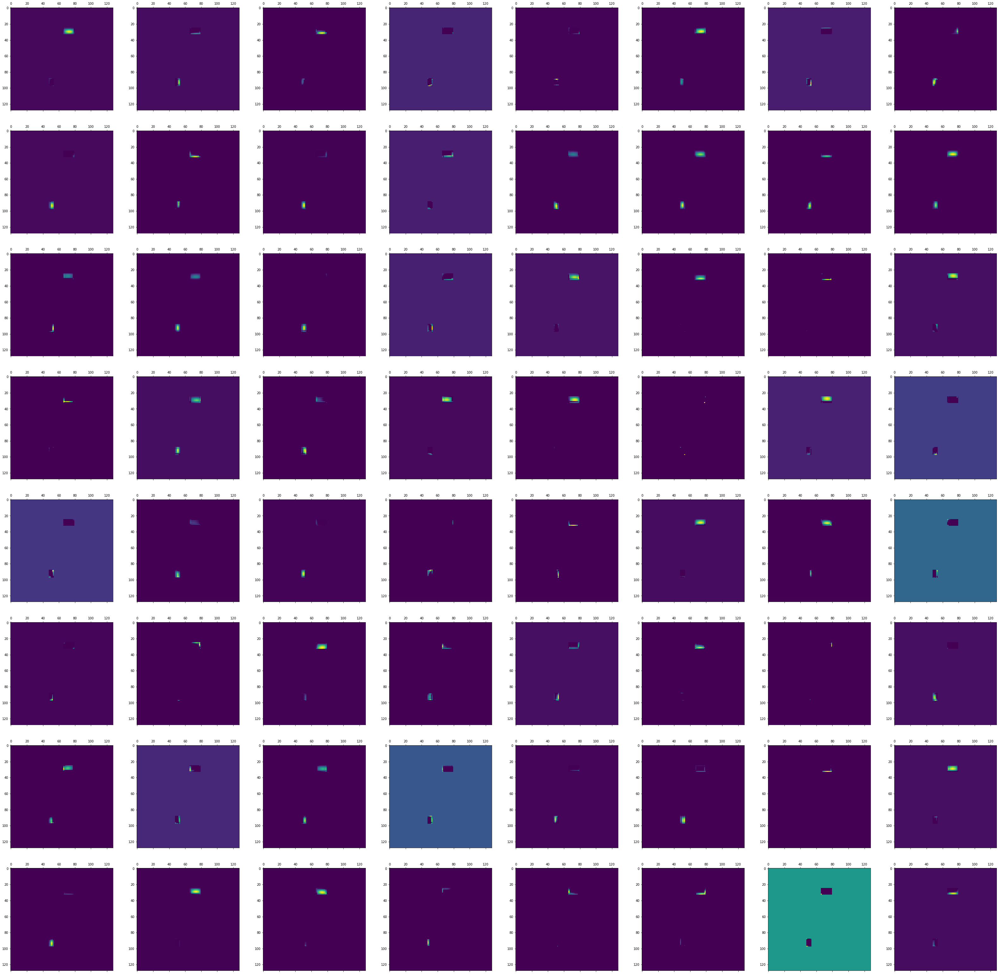

In [155]:
 display_activations(activations, 0)

#### Display Activations Group 2


Layer: 1  -  block2_pool    Shape:  (128, 128, 64)  # features:  64 8 8


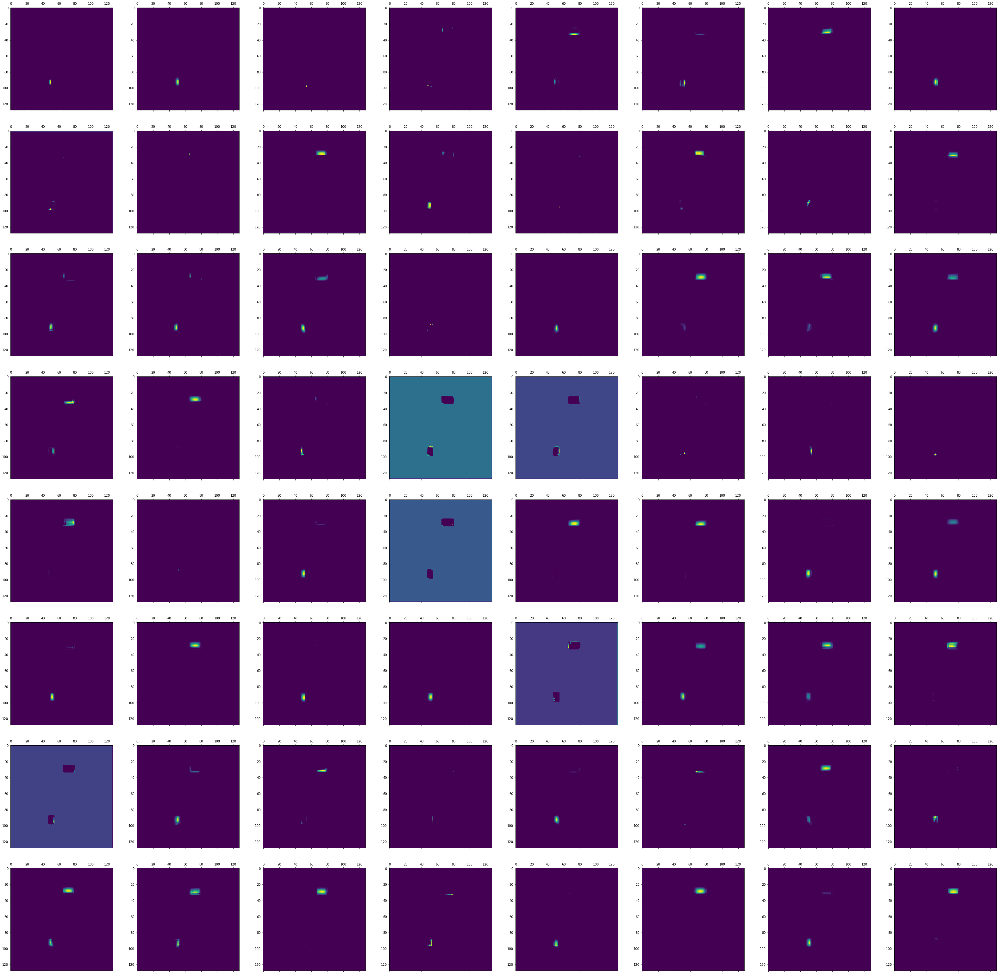

In [156]:
display_activations(activations,1)

#### Display Activations Group 3


Layer: 2  -  block3_pool    Shape:  (64, 64, 64)  # features:  64 8 8


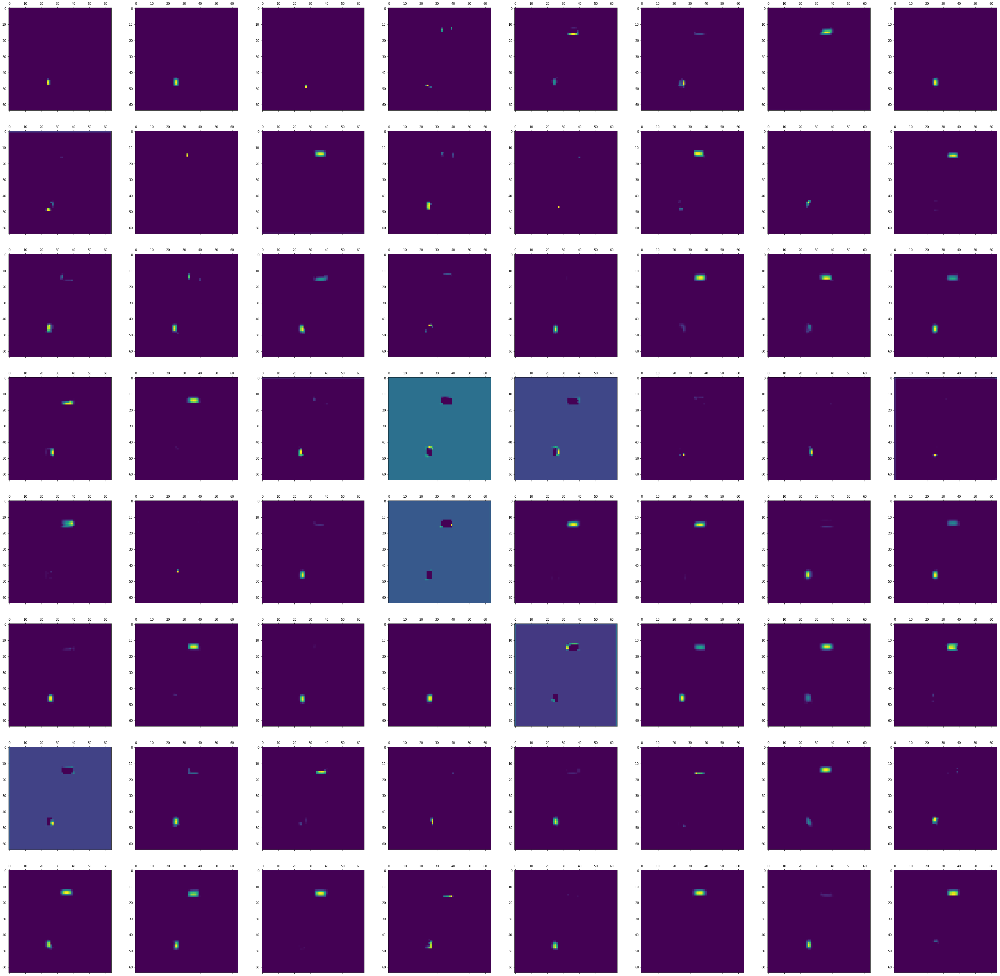

In [157]:
display_activations(activations,2)

#### Display Activations Group 4

In [162]:
display_activations(activations,3)

#### Display Activations Group 5


Layer: 4  -  block5_pool    Shape:  (64, 64, 128)  # features:  128 16 8


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\matplotlib\image.py:395: UserWarning: Warning: converting a masked element to nan.
  dv = (np.float64(self.norm.vmax) -
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\matplotlib\image.py:396: UserWarning: Warning: converting a masked element to nan.
  np.float64(self.norm.vmin))
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\matplotlib\image.py:403: UserWarning: Warning: converting a masked element to nan.
  a_min = np.float64(newmin)
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\matplotlib\image.py:408: UserWarning: Warning: converting a masked element to nan.
  a_max = np.float64(newmax)
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\matplotlib\colors.py:902: UserWarning: Warning: converting a masked element to nan.
  dtype = np.min_scalar_type(value)
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\numpy\ma\core.py:716: UserWarning: Warning: converting a masked element to nan.
  data = np.array(a, copy

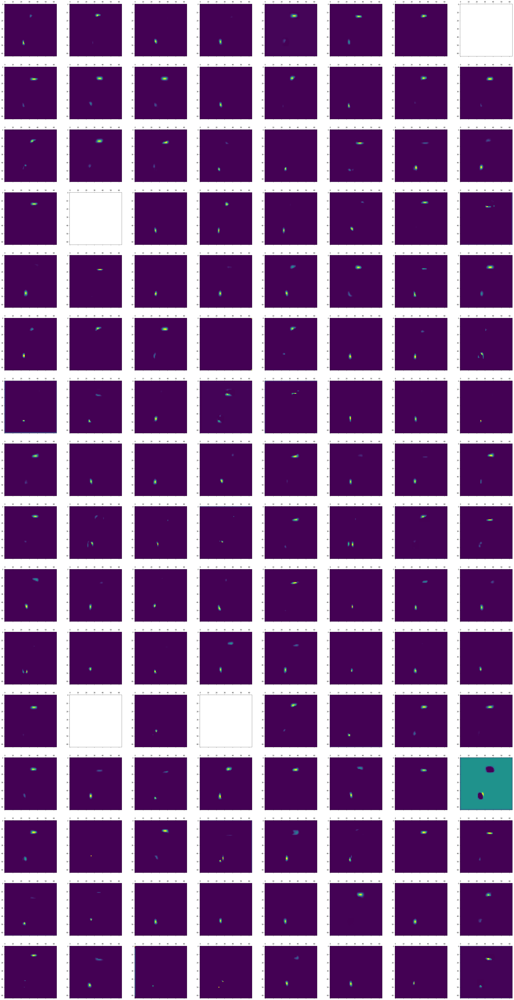

In [159]:
display_activations(activations,4)

#### Display Activations Group 6

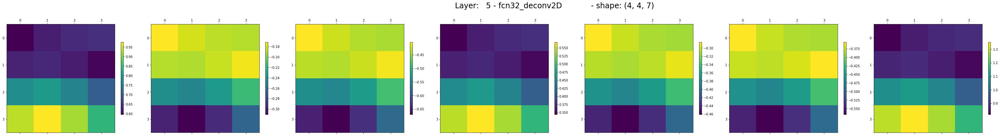

In [206]:
display_activations(activations,5)

#### Display Activations Group 7

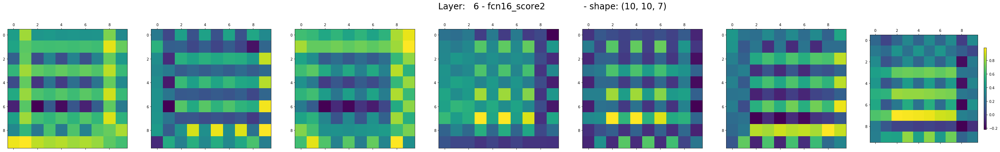

In [204]:
display_activations(activations,6)

#### Display Activations Group 8


Layer: 7  -  fcn16_score_pool4    Shape:  (8, 8, 7)  # features:  7 1 8


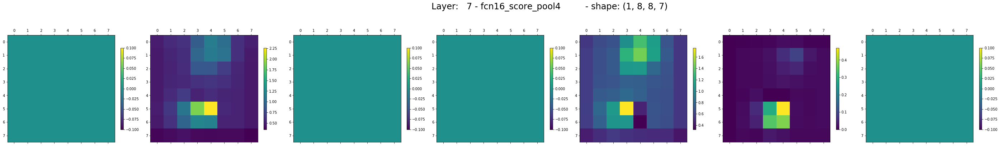

In [200]:
display_activations(activations,7)

#### Display Activations Group 9

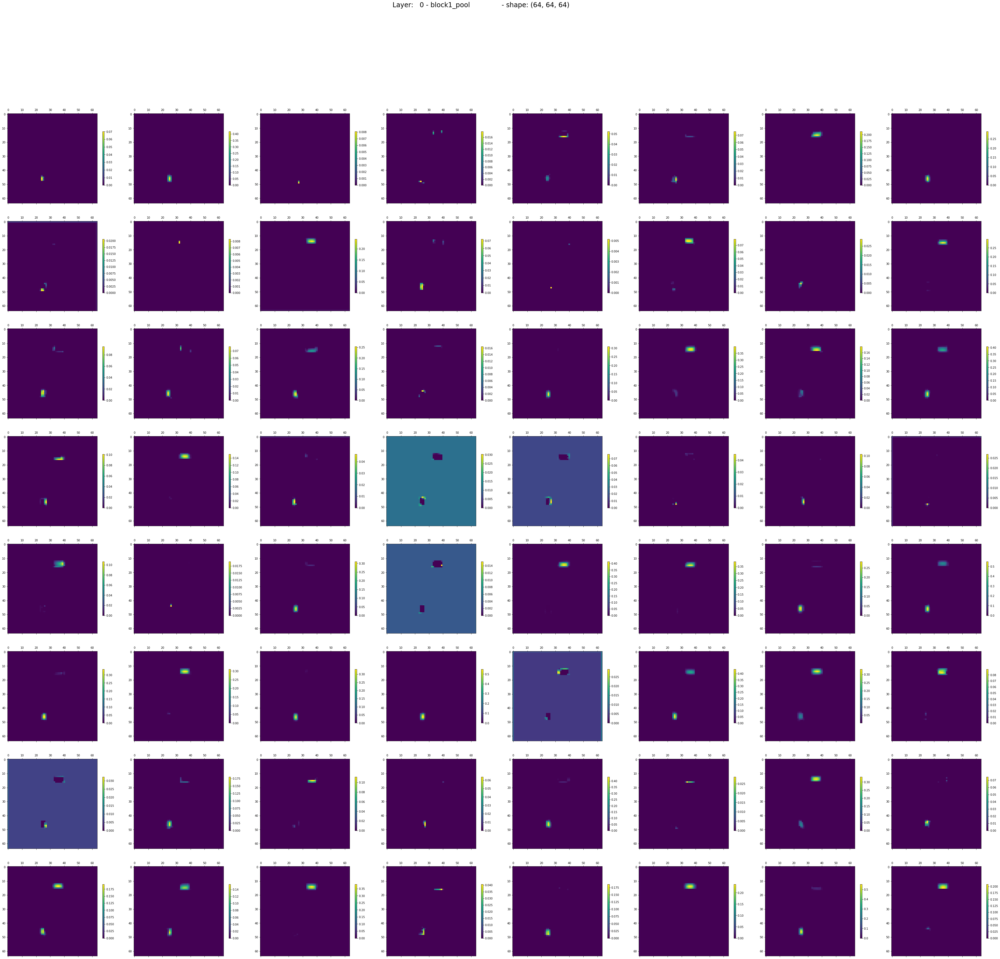

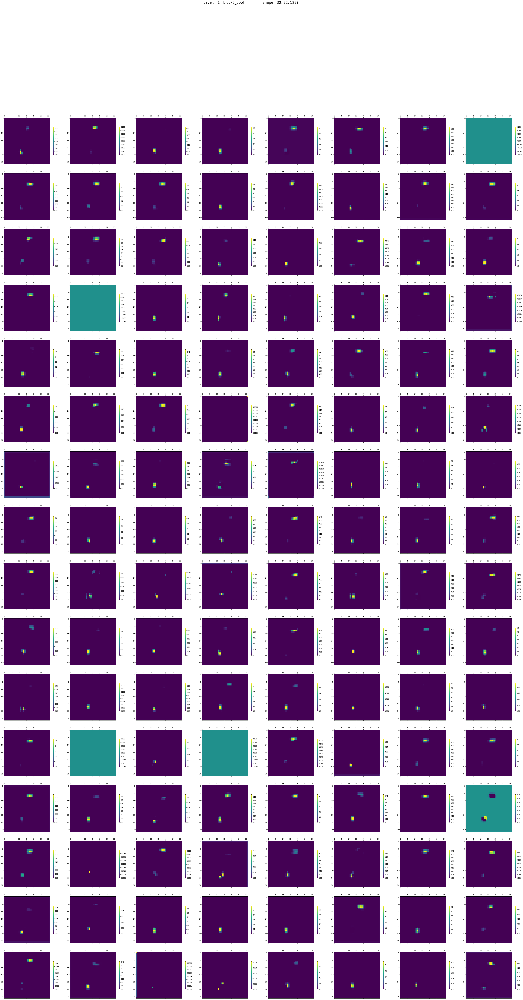

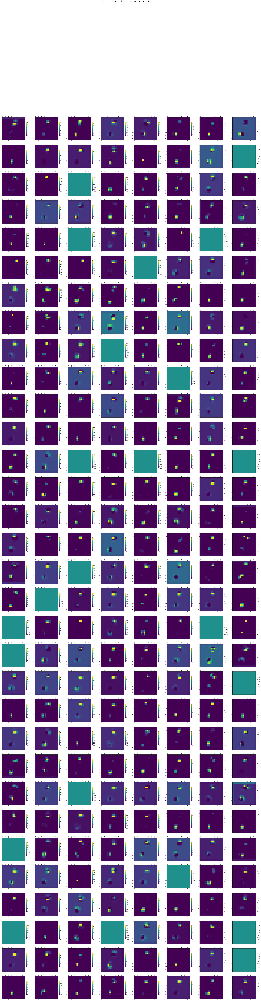

In [ ]:
# display_activations(activations,9, columns = 3)
for i in range(5):
    display_activations(activations, i)

#### Display Activations Group 10

In [198]:
str(activations[0].shape)

'(1, 64, 64, 64)'

### Display Activations 

In [ ]:
# layer_names = []
# for layer in model.layers[2:11]:
#     layer_names.append(layer.name)
images_per_row = 16
for layer_name, layer_activation in zip(layer_names[:5], activations[:5]):
    n_features = layer_activation.shape[-1]
    size = layer_activation.shape[1]
    n_rows = n_features // images_per_row
    scale = 1./size
    ratio = images_per_row/n_rows
    
    display_grid = np.zeros((size * n_rows,  size * images_per_row ))
    
    print(layer_name, ' layer_activation: ' , layer_activation.shape, ' n_features: ', n_features, '  size: ', size, 'sclae: ', scale,'  display_gird.shape ', display_grid.shape, ' n_rows: ', n_rows, 'ratio: ', ratio)
    print('   Figure size:', scale * display_grid.shape[1] *ratio, ' by ', scale * display_grid.shape[1])
    
    for row in range(n_rows):
        for col in range(images_per_row):
            
            channel_image = layer_activation[0,:,:, row * images_per_row + col]
            c_min  = channel_image.min()
            c_max  = channel_image.max()
            c_mean = channel_image.mean()
            c_std  = channel_image.std()
            
            ## Normalize to mean 0 , std_dev = 1
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image -= 128
            
#             a_min  = channel_image.min()
#             a_max  = channel_image.max()
#             a_mean = channel_image.mean()
#             a_std  = channel_image.std()
            
#             print(' channel:{:4d}    min: {:9.4f}   max: {: 9.4f}   BEFORE mean:{:8.4f}  std:{:8.4f}'.format(
#                         col*images_per_row+row,c_min, c_max, c_mean, c_std))
            channel_image = np.clip(channel_image,0,255).astype('uint8')
            display_grid[(row*size): (row+1)*size, (col*size):(col+1)*size] = channel_image
                   
            
            
            
#     scale  = 1.
#     plt.figure(figsize = (scale * display_grid.shape[1]*ratio, scale * display_grid.shape[1]))
    plt.figure(figsize = (16, 16/ratio))
    plt.title(layer_name)
#     plt.grid(True)
    for xval in np.linspace(0.0,   display_grid.shape[1], images_per_row+1 ):
#         print('xval:', xval)
        plt.vlines(xval, 0.0,   display_grid.shape[0], color='white', alpha=1, linestyles='dashed', linewidth=.5)
    
    for yval in np.linspace(0.0,   display_grid.shape[0], n_rows+1 ):
#         print('yval:', yval)        
        plt.hlines(yval, 0.0,   display_grid.shape[1], color='white', alpha=1, linestyles='dashed', linewidth=.5)
    
    plt.imshow(display_grid, aspect='auto', cmap='jet')
    

## Visualizing the filters

In [87]:
import keras.backend as KB
layer_name = 'block1_conv1'
filter_index = 0 
layer_output = model.get_layer(layer_name).output
loss = KB.mean(layer_output[:,:,:,filter_index])
grads = KB.gradients(loss, model.input)[0]

print(' model input: ', model.input)
print('layer_output: ', layer_output)
print('        loss: ', loss)
print('       grads: ', grads)


 model input:  [<tf.Tensor 'input_pr_hm_norm:0' shape=(?, 128, 128, 7) dtype=float32>, <tf.Tensor 'input_pr_hm_scores:0' shape=(?, 7, 64, 24) dtype=float32>]
layer_output:  Tensor("block1_conv1/Relu:0", shape=(?, 128, 128, 64), dtype=float32)
        loss:  Tensor("Mean_6:0", shape=(), dtype=float32)
       grads:  Tensor("gradients_6/block1_conv1/convolution_grad/Conv2DBackpropInput:0", shape=(?, 128, 128, 7), dtype=float32)


In [88]:
iterate = KB.function(model.input, [loss, grads])
inp1 = np.zeros((1,128,128,7))
inp2 = np.zeros((0,7,64,24))
loss_value, grads_value = iterate([inp1, inp2])

(1, 128, 128, 7)


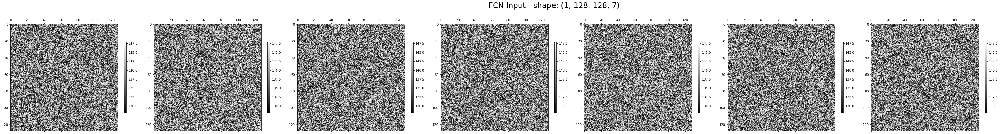

In [138]:
# input_img_data = np.random.random((1,128,128,7))*20 + 128
# inp2 = np.zeros((0,7,64,24))
print(input_img_data.shape)
# plt.imshow(input_img_data[0,:,:,0], cmap = 'gray')
display_fcn_input(input_img_data)

In [ ]:
step = 2.
# input_img_data = np.random.random((1,128,128,7))*20 + 128
# inp2 = np.zeros((0,7,64,24))

for i in range(50000):
    loss_val, grads_val = iterate([input_img_data, inp2])
    if i % 1000 == 0 :
        print(i, 'loss: ', loss_val, np.sum(input_img_data, axis= (0,1,2)), grads_val.shape, np.sum(grads_val, axis= (0,1,2)))
    input_img_data -=grads_val * step

0 loss:  20.372967 [2256986.5755 2266880.0110 2257597.7075 2269954.3518 2279264.2258 2241235.6987 2234698.3191] (1, 128, 128, 7) [ 0.0365 -0.0665  0.0303 -0.0880 -0.1670  0.1825  0.2260]
1000 loss:  20.357357 [2256913.5792 2267013.0706 2257537.1033 2270130.3663 2279598.1825 2240870.5862 2234246.2943] (1, 128, 128, 7) [ 0.0365 -0.0665  0.0303 -0.0880 -0.1670  0.1825  0.2260]
2000 loss:  20.341747 [2256840.5830 2267146.1302 2257476.4992 2270306.3809 2279932.1391 2240505.4736 2233794.2695] (1, 128, 128, 7) [ 0.0365 -0.0665  0.0303 -0.0880 -0.1670  0.1825  0.2260]
3000 loss:  20.32615 [2256767.5867 2267279.1897 2257415.8951 2270482.3955 2280266.0957 2240140.3611 2233342.2447] (1, 128, 128, 7) [ 0.0365 -0.0665  0.0303 -0.0880 -0.1670  0.1825  0.2260]
4000 loss:  20.310535 [2256694.5904 2267412.2493 2257355.2910 2270658.4101 2280600.0524 2239775.2486 2232890.2200] (1, 128, 128, 7) [ 0.0365 -0.0665  0.0303 -0.0880 -0.1670  0.1825  0.2260]
5000 loss:  20.29492 [2256621.5942 2267545.3088 225729

21.20742
(1, 128, 128, 7) [ 0.0365 -0.0665  0.0303 -0.088  -0.167   0.1825  0.226 ]


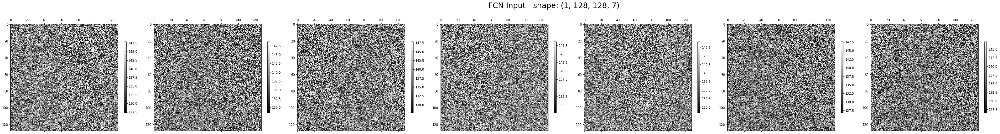

In [194]:
display_fcn_input(input_img_data)

## Display Heatmaps

### 2D Plots  

####  2D plot of `model_gt_heatmap` returned from model

 Image Id:  0  Display classes: [0, 1, 25, 31, 32]
 rows   2  columns : 3
 min_z_all shape: ()  min_z_all: -0.058524482  max_z_all: () max_z_all: 1.1999353
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == all


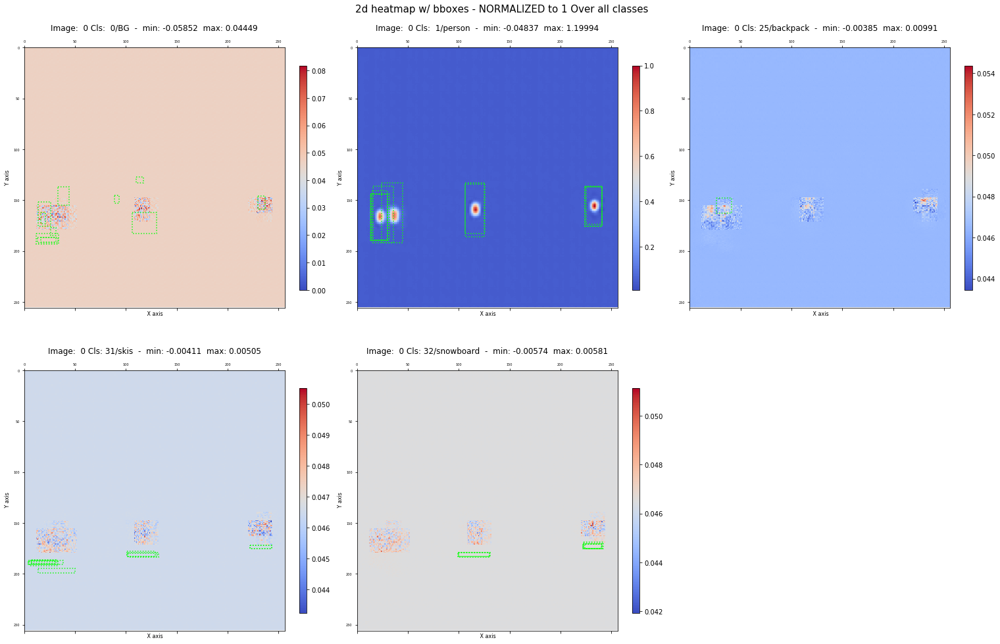

In [140]:
fig = visualize.plot_2d_heatmap(model_fcn_heatmap, model_pr_heatmap_scores, img_id, pr_class_ids, columns = 3,
                          class_names = coco_class_names, scale = 4, scaling = 'all')

 Image Id:  0  Display classes: [0, 1, 31]
 rows   1  columns : 3
 min_z_all shape: ()  min_z_all: 0.0  max_z_all: () max_z_all: 1.0
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == all


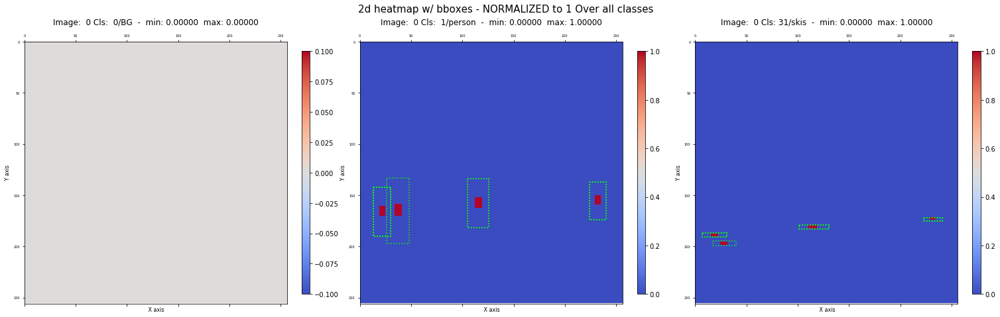

In [138]:
fig = visualize.plot_2d_heatmap(model_gt_heatmap, model_gt_heatmap_scores, img_id, gt_class_ids, 
                          class_names = coco_class_names, columns = 3, scale = 4, scaling = 'all')

####  2D plot of `pred_heatmap_norm` returned from MRCNN 

 Image Id:  0  Display classes: [0, 1, 25, 31, 32]
 rows   2  columns : 3
 min_z_all shape: ()  min_z_all: 0.0  max_z_all: () max_z_all: 1.0
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == all


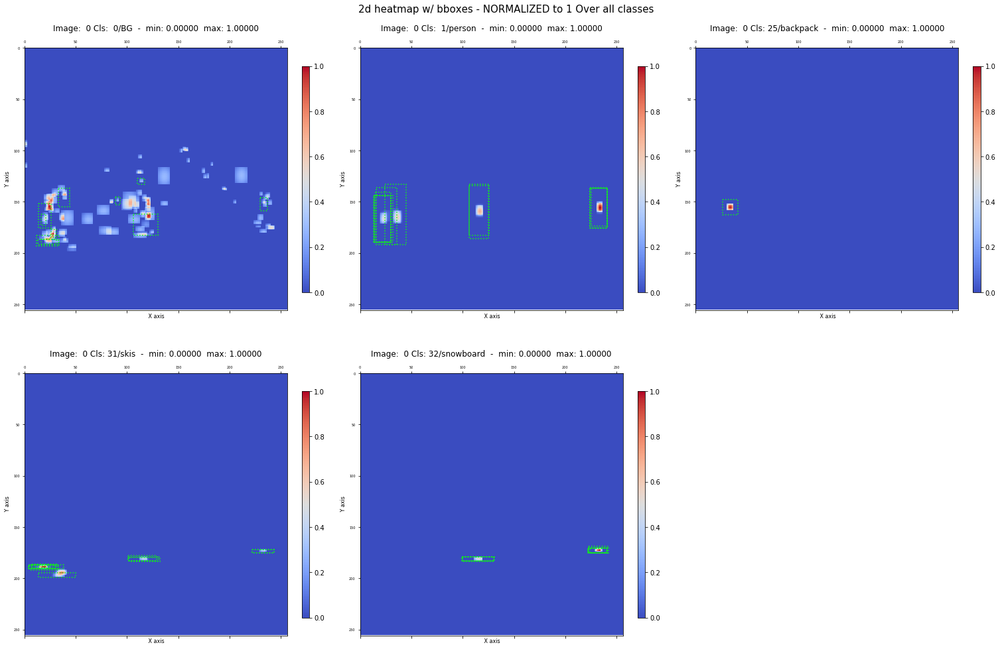

In [141]:
fig = visualize.plot_2d_heatmap(model_pr_heatmap, model_pr_heatmap_scores, img_id, pr_class_ids, columns = 3, 
                            class_names = coco_class_names, scale = 4, scaling = 'all')

####  2D plot of `model_fcn_heatmap` returned from model

####  2D plot of `model_fcn_heatmap` returned from model - ALL CLASSES

 Image Id:  0  Display all classes...
 rows   27  columns : 3
 min_z_all shape: ()  min_z_all: -0.058524482  max_z_all: () max_z_all: 1.1999353
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == all


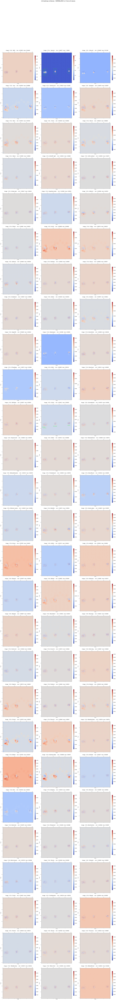

In [142]:
fig = visualize.plot_2d_heatmap(model_fcn_heatmap, model_gt_heatmap_scores, img_id,
                                class_names = coco_class_names, columns = 3, scale = 4, scaling = 'all')

In [ ]:
fig.savefig('fcn_heatmaps_2d.png')

####  2D comparative display `pred_heatmap` / `fcn_heatmap`  

Display classes: [0, 1, 2, 3, 10]


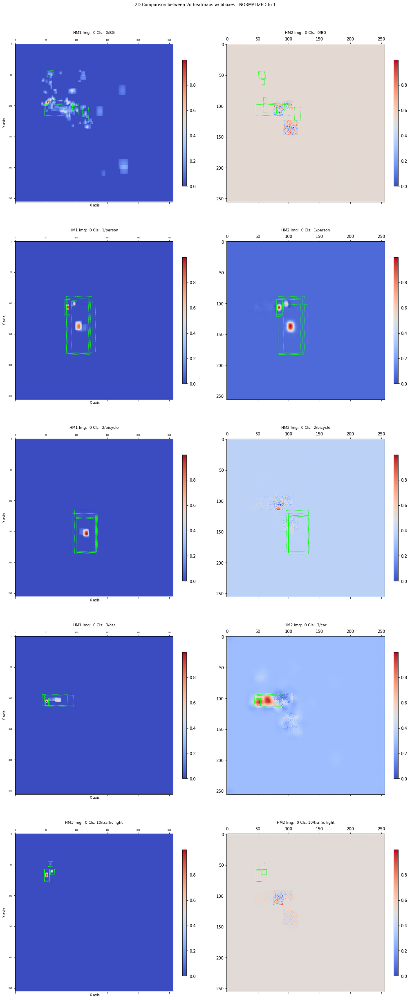

In [20]:
fig = visualize.plot_2d_heatmap_compare(model_pr_heatmap, model_fcn_heatmap, model_pr_heatmap_scores, 
                        img_id, class_ids = pr_class_ids, class_names = coco_class_names, scale = 4, scaling = True )    

###  3D Plots

####  3D plot of  `gt_heatmap_norm` returned form code above

Image : 0  ClassIds: [0, 1, 2, 8, 10]
Display classes: [0, 1, 2, 8, 10]
rows   3  columns : 2
 min_z_all shape: ()  min_z_all: 0.0  max_z_all: () max_z_all: 1.0
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
zlim = all   zlim_min : 0.00000000 zlim_max: 1.00000000 
 SCALING == class


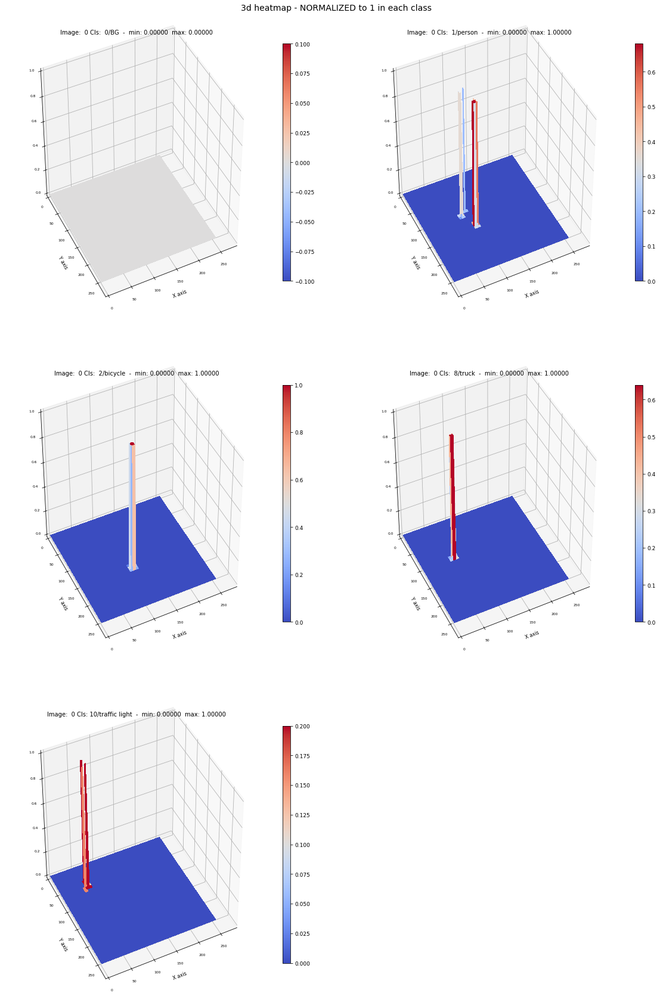

In [34]:
print('Image : {}  ClassIds: {}'.format(img_id, gt_class_ids))
visualize.plot_3d_heatmap(model_gt_heatmap, img_id, gt_class_ids, class_names = coco_class_names, scaling='class')

####  3D plot of `pred_heatmap_norm` returned form model

Image : 0  ClassIds: [0, 1, 2, 3, 10]
Display classes: [0, 1, 2, 3, 10]
rows   3  columns : 2
 min_z_all shape: ()  min_z_all: 0.0  max_z_all: () max_z_all: 1.0
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == none 
1 zlim = each  zlim_min : 0.00000000 zlim_max: 1.00000000 
1 zlim = each  zlim_min : 0.00000000 zlim_max: 1.00000000 
1 zlim = each  zlim_min : 0.00000000 zlim_max: 1.00000000 
1 zlim = each  zlim_min : 0.00000000 zlim_max: 1.00000000 
1 zlim = each  zlim_min : 0.00000000 zlim_max: 1.00000000 


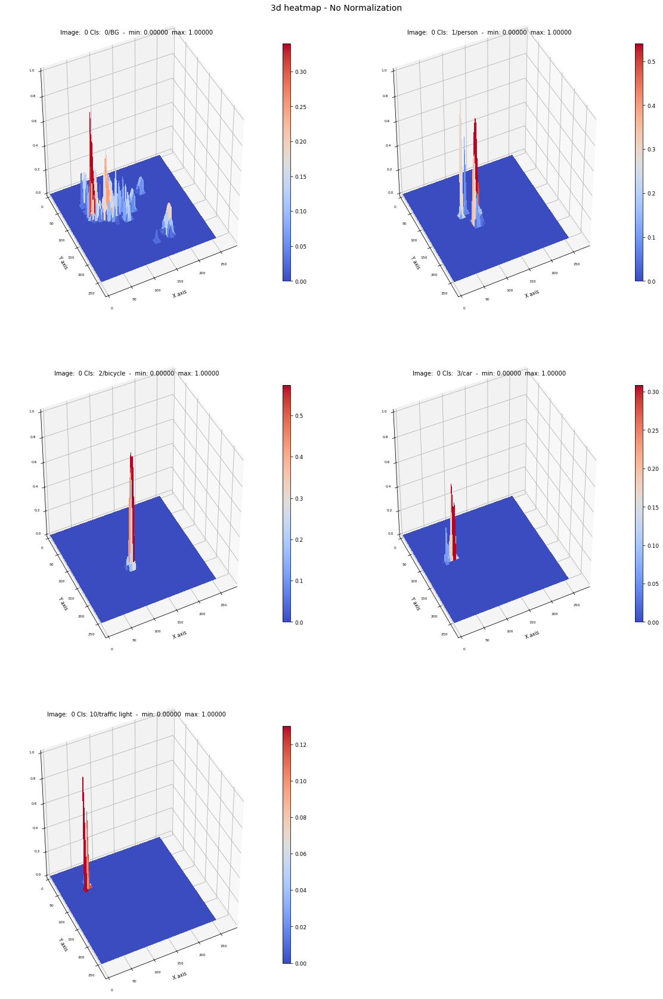

In [38]:
print('Image : {}  ClassIds: {}'.format(img_id, pr_class_ids))
visualize.plot_3d_heatmap(model_pr_heatmap, img_id, pr_class_ids, class_names = coco_class_names, zlim = 'class' , scaling = 'none')

####  3D plot of `fcn_heatmap` returned form model - only classes in pred_scores

1.0054814 -0.07213605
Image : 0  ClassIds: [0, 1, 2, 3, 10]
Display classes: [0, 1, 2, 3, 10]
rows   3  columns : 2
 min_z_all shape: ()  min_z_all: -0.07213605  max_z_all: () max_z_all: 1.0054814
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == none 
1 zlim = each  zlim_min : -0.04918735 zlim_max: 0.04423909 
1 zlim = each  zlim_min : -0.07213605 zlim_max: 1.00548136 
1 zlim = each  zlim_min : -0.00786482 zlim_max: 0.01213216 
1 zlim = each  zlim_min : -0.00898363 zlim_max: 0.02093699 
1 zlim = each  zlim_min : -0.00705333 zlim_max: 0.00658484 


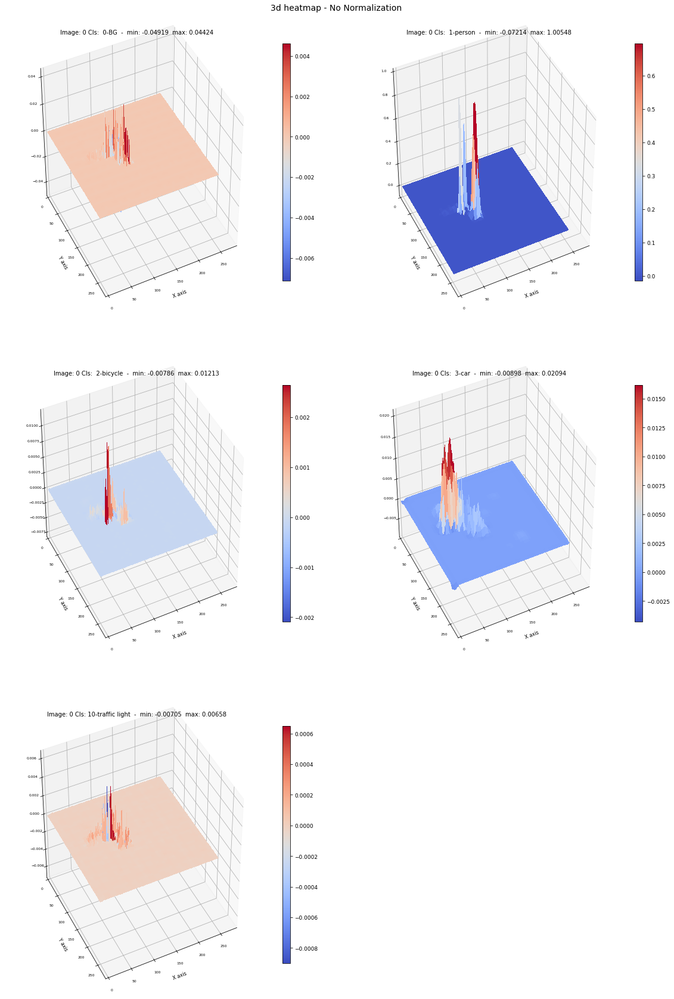

In [44]:
print(np.max(model_fcn_heatmap), np.min(model_fcn_heatmap))

print('Image : {}  ClassIds: {}'.format(img_id, pr_class_ids))
visualize.plot_3d_heatmap(model_fcn_heatmap, img_id, pr_class_ids,class_names = coco_class_names, scaling = 'none')

####  3D plot of `fcn_heatmap` returned form model - all classes

Image : 0  ClassIds: [0, 1, 2, 3, 10]
Display all classes...
rows   21  columns : 4
 min_z_all shape: ()  min_z_all: -0.07213605  max_z_all: () max_z_all: 1.0054814
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == all
zlim = all   zlim_min : -0.07213605 zlim_max: 1.00548136 


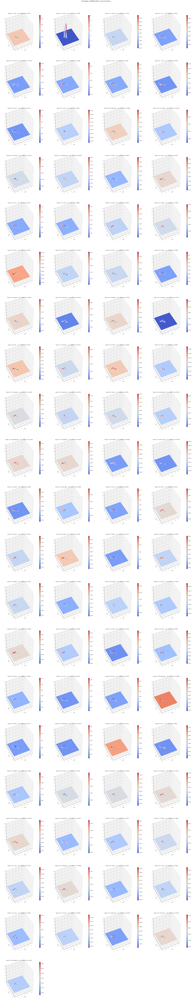

In [45]:
print('Image : {}  ClassIds: {}'.format(img_id, pr_class_ids))
#     plot_3d_heatmap(model_fcn_heatmap, img_id, class_ids,class_names = class_names, size = (8,8), zlim=0)
visualize.plot_3d_heatmap(model_fcn_heatmap, img_id, class_names = coco_class_names, columns = 3,scaling = 'all')

####  3D comparative display `pred_heatmap` / `fcn_heatmap` 

In [ ]:
print('Image : {}  ClassIds: {}'.format(img_id, pr_class_ids))
visualize.plot_3d_heatmap_compare(model_pr_heatmap, model_fcn_heatmap, img_id, class_ids = pr_class_ids, 
                            class_names = coco_class_names, size=(8,8), zlim = 'all' , scaling = 'all')

####  3D comparative display `gt_heatmap` / `fcn_heatmap` 

Image : 0  ClassIds: [0, 1, 2, 8, 10]
Display classes: [0, 1, 2, 8, 10]
 image height/width  256 256
shape pos  (256, 256, 2) shape Z1:  (256, 256, 81) shape Z2: (256, 256, 81)
 min_z1_all shape: ()  min_z1_all: 0.0  max_z1_all: () max_z1_all: 1.0
 min_z2_all shape: ()  min_z2_all: -0.07213605  max_z2_all: () max_z2_all: 1.0054814
 min_z_all shape: ()  min_z_all: -0.07213605  max_z_all: () max_z_all: 1.0054814
 min_z1_cls shape: (1, 1, 81)  max_z1_cls shape: (1, 1, 81)
 min_z2_cls shape: (1, 1, 81)  max_z2_cls shape: (1, 1, 81)
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
ttl:  HM1 Img:  0 Cls:  0/BG  -  min: 0.00000  max: 0.00000
ttl:  HM2 Img:  0 Cls:  0/BG  -  min: -0.04919  max: 0.04424
ttl:  HM1 Img:  0 Cls:  1/person  -  min: 0.00000  max: 1.00000
ttl:  HM2 Img:  0 Cls:  1/person  -  min: -0.07214  max: 1.00548
ttl:  HM1 Img:  0 Cls:  2/bicycle  -  min: 0.00000  max: 1.00000
ttl:  HM2 Img:  0 Cls:  2/bicycle  -  min: -0.00786  max: 0.01213
ttl:  HM1 Img:  0 Cls:  8/t

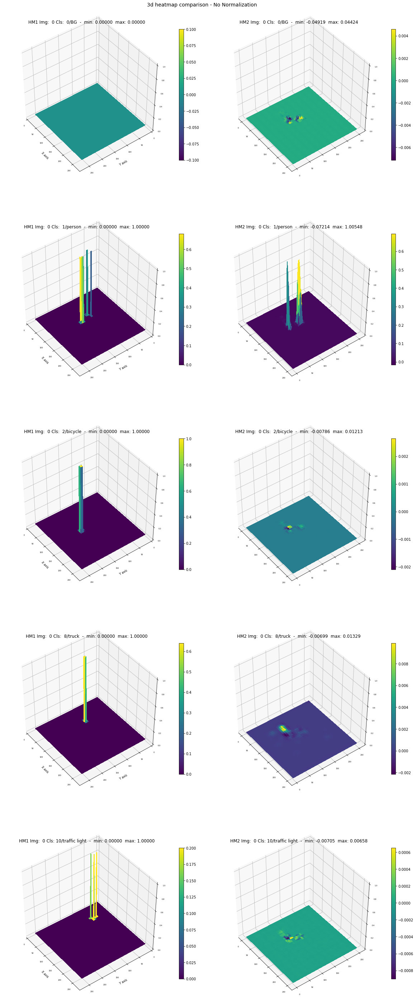

In [73]:
print('Image : {}  ClassIds: {}'.format(img_id, gt_class_ids))
visualize.plot_3d_heatmap_compare(model_gt_heatmap, model_fcn_heatmap, img_id, gt_class_ids, class_names = coco_class_names, scaling = 'none')

### Overlay predictions on image

#### Overlay image with gt_heatmaps

Image shape : (1024, 1024, 3)  class_ids: [ 0  1  2  8 10]


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\util\dtype.py:130: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


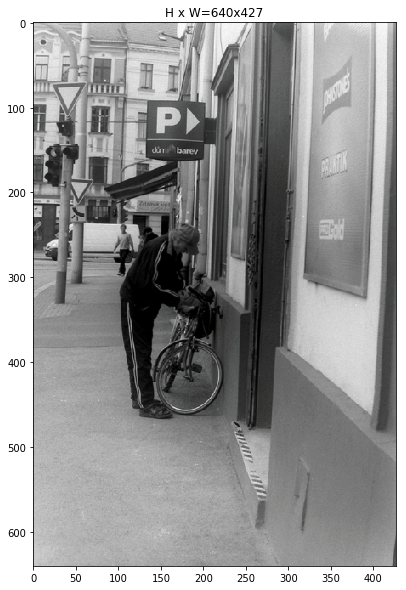

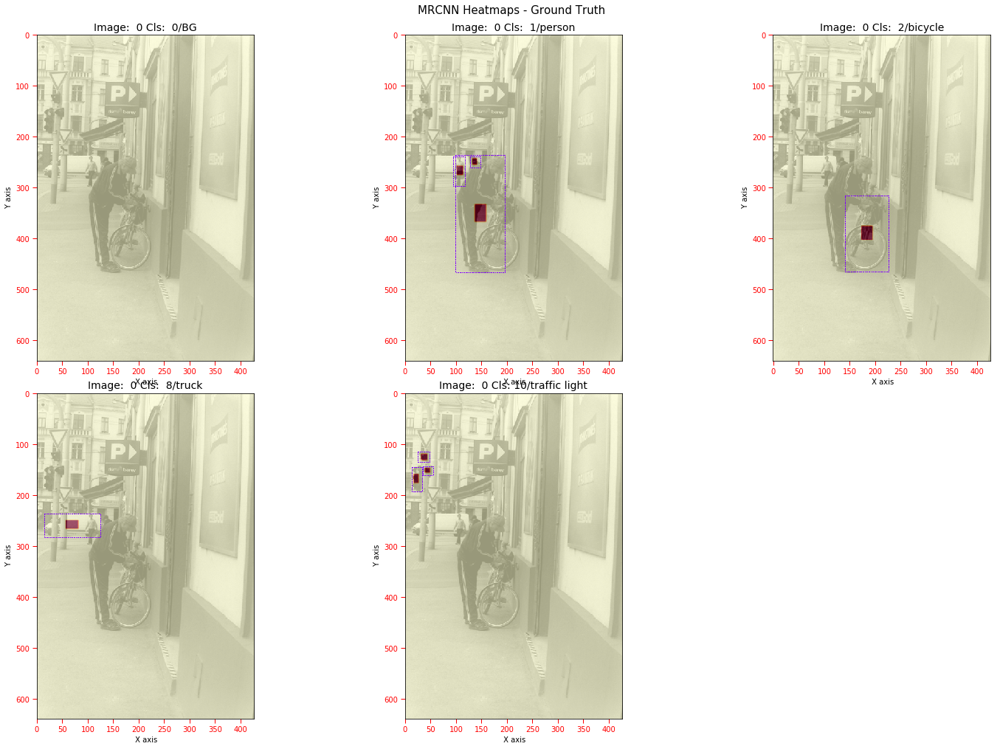

In [75]:
visualize.display_heatmaps_mrcnn(mrcnn_input, mrcnn_output, 0, hm = 'gt', columns = 3, 
                     config = mrcnn_model.config, class_ids = gt_class_ids, class_names = coco_class_names)

#### Overlay image with pred_heatmaps

Image shape : (1024, 1024, 3)  class_ids: [ 0  1  2  3 10]


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\util\dtype.py:130: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


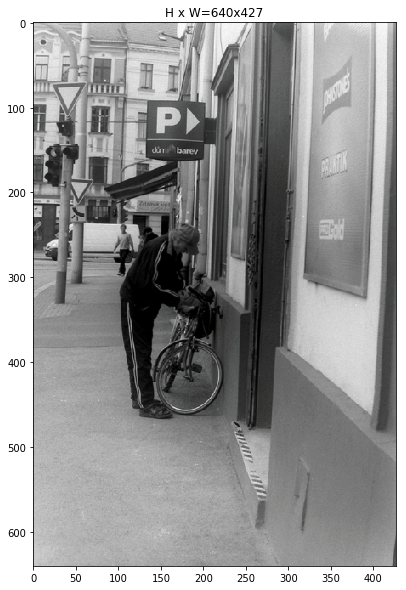

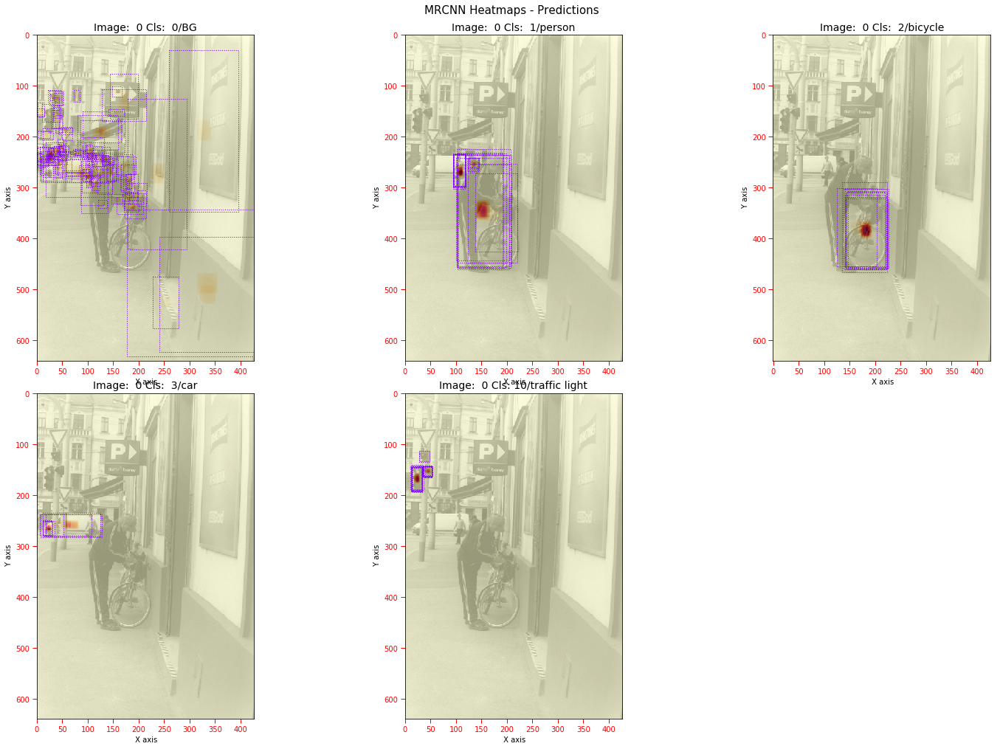

In [76]:
visualize.display_heatmaps_mrcnn(mrcnn_input, mrcnn_output, 0, hm = 'pr', columns = 3,
                     config = mrcnn_model.config, class_ids = pr_class_ids, class_names = coco_class_names)

#### Overlay image with fcn_heatmaps

 Bounding boxes shape:  (81, 200, 11)
Image shape : (1024, 1024, 3)  class_ids: [0, 1, 2, 8, 10]


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\util\dtype.py:130: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


 min_z_all:  () -0.07213605  max_z_all : () 1.0054814
 SCALING == none (clip to [-1, +1])
 Title:  Img: 0 Cls:  0/BG  -  min: -0.04919  max: 0.04424
 Title:  Img: 0 Cls:  1/person  -  min: -0.07214  max: 1.00000
 Title:  Img: 0 Cls:  2/bicycle  -  min: -0.00786  max: 0.01213
 Title:  Img: 0 Cls:  8/truck  -  min: -0.00699  max: 0.01329
 Title:  Img: 0 Cls: 10/traffic light  -  min: -0.00705  max: 0.00658


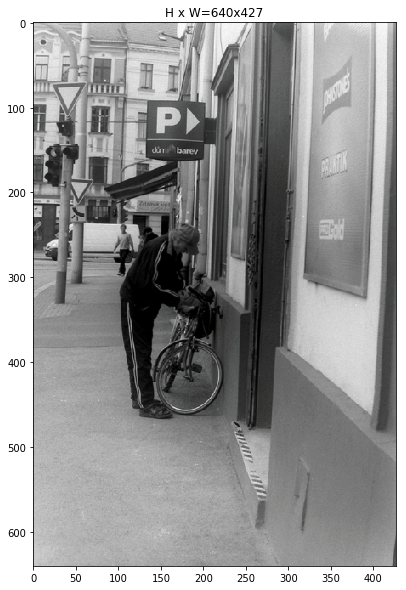

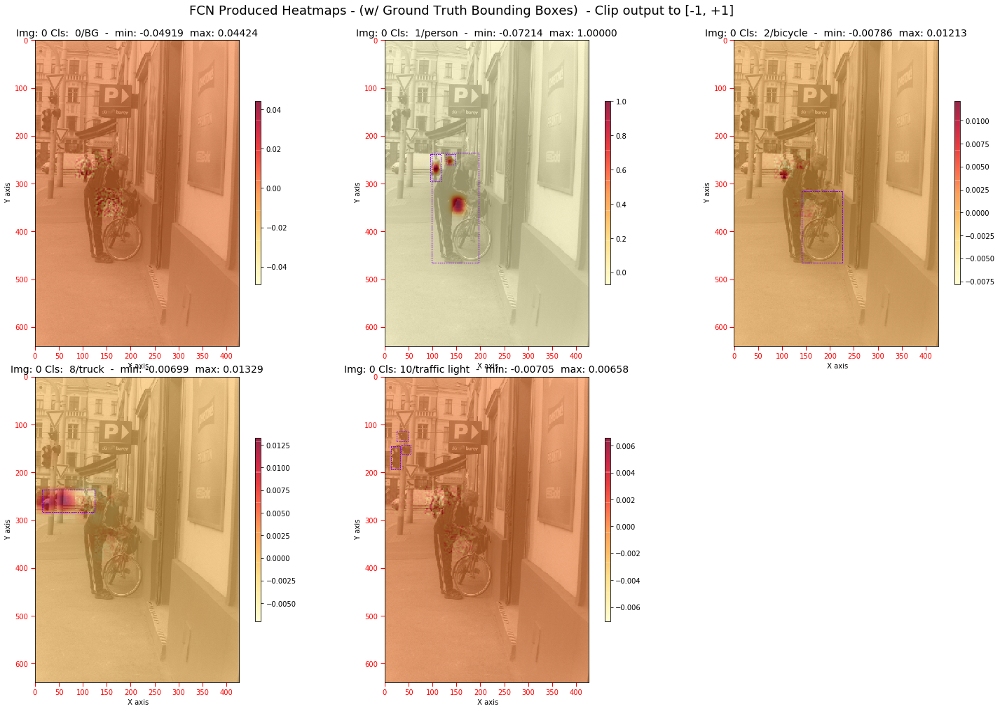

In [106]:
visualize.display_heatmaps_mrcnn_fcn(mrcnn_input, mrcnn_output, 0, heatmap = model_fcn_heatmap, hm = 'gt', columns = 3,
                     config = mrcnn_model.config, class_ids = gt_class_ids, class_names = coco_class_names, scaling = 'clip')

In [94]:
from IPython.core.display import HTML
HTML("""
<style>
.output_png {
    display: table-cell;
    text-align: center;
    vertical-align: center;
}
</style>
""")

#### Overlay image with gt_heatmaps and fcn_heatmaps

 Bounding boxes shape:  (81, 200, 11)
Image shape : (1024, 1024, 3)  class_ids: [0, 1, 2, 8, 10]


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\util\dtype.py:130: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


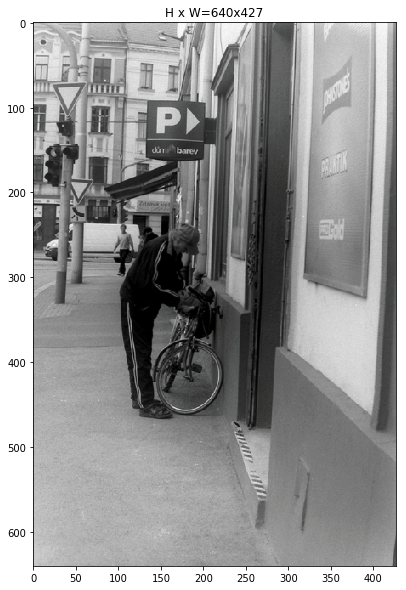

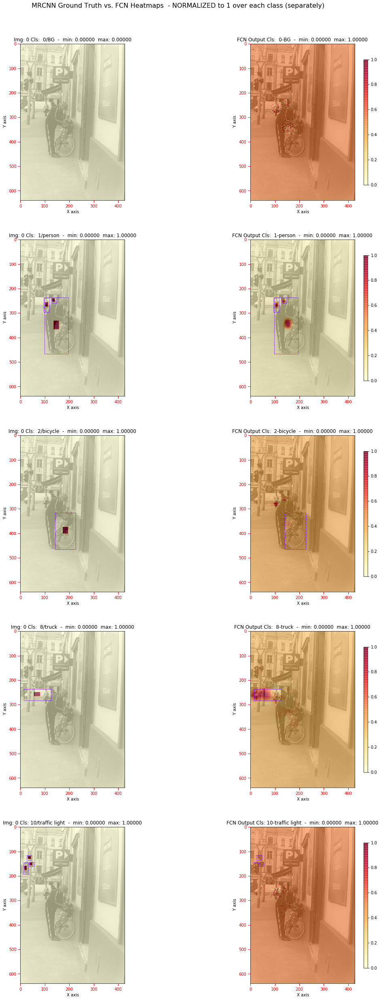

In [119]:
visualize.display_heatmaps_compare(mrcnn_input, mrcnn_output, heatmap = model_fcn_heatmap, image_id = 0, 
                                   hm = 'gt', config = mrcnn_model.config, class_ids = gt_class_ids, class_names = coco_class_names, scaling = 'each')

#### Overlay image with pr_heatmaps and fcn_heatmaps

 Bounding boxes shape:  (81, 200, 11)
Image shape : (1024, 1024, 3)  class_ids: [0, 1, 2, 8, 10]


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\util\dtype.py:130: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


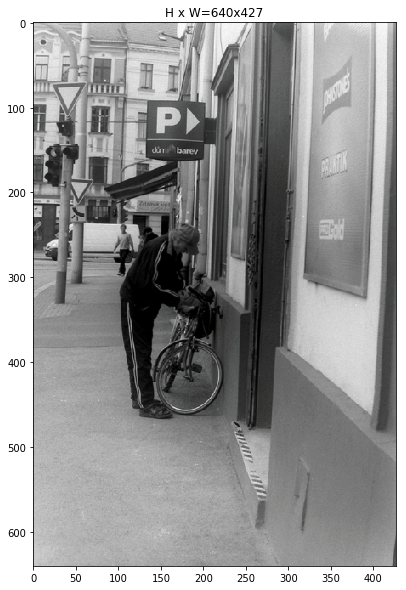

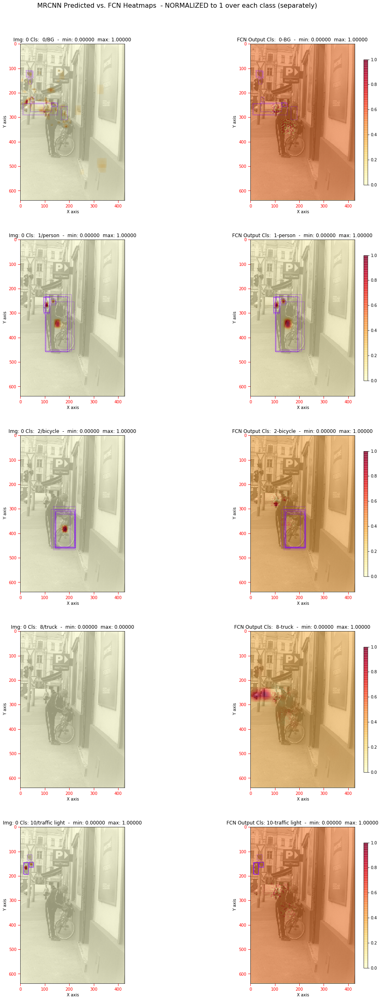

In [120]:
visualize.display_heatmaps_compare(mrcnn_input, mrcnn_output, heatmap = model_fcn_heatmap, image_id = 0, hm = 'pr', 
                     config = mrcnn_model.config, class_ids = gt_class_ids, class_names = coco_class_names, scaling = 'each')